# Thesis Figures

# Import packages

In [1]:
%load_ext autoreload
%autoreload 2

import copy
from antarctic_plots import utils, regions, maps, fetch, profile
import zarr
import harmonica as hm
import numpy as np
import pandas as pd
import xarray as xr
import matplotlib.pyplot as plt
import verde as vd
import scipy as sp
import pvxarray
import rioxarray
import pygmt
import geopandas as gpd
import plotly.graph_objects as go
import warnings
import pathlib
import pickle
import seaborn as sns
import string
import pooch
import itertools

from RIS_gravity_inversion import gravity_processing as grav
from RIS_gravity_inversion import utils as inv_utils

sns.set_theme()
import os

In [2]:
regions.ross_ice_shelf

[-680000.0, 470000.0, -1420000.0, -310000.0]

In [3]:
# region = regions.ross_ice_shelf
region = [-760e3, 600e3, -1700e3, -350e3]

buffer_region = vd.pad_region(region, 40e3)
spacing = 5e3
registration = "g"
reference = "ellipsoid"

# Topo data

In [4]:
# bedmachine_surface = fetch.bedmachine(
#     layer="surface",
#     reference=reference,
#     region=buffer_region,
#     spacing=500,
#     registration=registration,
# )

# bedmachine_icebase = fetch.bedmachine(
#     layer="icebase",
#     reference=reference,
#     region=buffer_region,
#     spacing=500,
#     registration=registration,
# )

In [5]:
# bedmachine_surface = bedmachine_surface.rename({"x": "easting", "y": "northing"})
# bedmachine_icebase = bedmachine_icebase.rename({"x": "easting", "y": "northing"})

In [6]:
# bedmachine_surface = bedmachine_surface.to_dataset(name="surface")
# bedmachine_icebase = bedmachine_icebase.to_dataset(name="icebase")

In [7]:
# bedmachine_surface.to_zarr(
#     "plotting/bedmachine_surface.zarr",
#     encoding={"surface": {"compressor": zarr.Blosc()}},
#     mode="w",
# )
# bedmachine_icebase.to_zarr(
#     "plotting/bedmachine_icebase.zarr",
#     encoding={"icebase": {"compressor": zarr.Blosc()}},
#     mode="w",
# )

In [8]:
bedmachine_surface = xr.open_zarr("plotting/bedmachine_surface.zarr").surface
bedmachine_icebase = xr.open_zarr("plotting/bedmachine_icebase.zarr").icebase
inverted_bed_full = xr.open_zarr("../RIS_gravity_inversion/results/antarctic_wide_results.zarr").bed

ocean_draft = bedmachine_icebase - inverted_bed_full

inverted_bed = fetch.resample_grid(
    inverted_bed_full,
    region=buffer_region,
    spacing=spacing,
    registration=registration,
)
basement = fetch.basement()
basement = fetch.resample_grid(
    basement,
    region=buffer_region,
    spacing=spacing,
    registration=registration,
).rename({"x":"easting","y":"northing"})
sediment_thickness = inverted_bed_full - basement

ocean_draft_5k = bedmachine_icebase - inverted_bed


/home/tankerma/miniconda/envs/RIS_gravity_inversion/lib/python3.10/site-packages/xarray/backends/plugins.py:71: RuntimeWarning: Engine 'cfgrib' loading failed:
Cannot find the ecCodes library
  warnings.warn(f"Engine {name!r} loading failed:\n{ex}", RuntimeWarning)


spacing larger than original, filtering and resampling


grdsample [WARNING]: Output sampling interval in x exceeds input interval and may lead to aliasing.
grdsample [WARNING]: Output sampling interval in y exceeds input interval and may lead to aliasing.


returning original grid
returning grid with new region and/or registration, same spacing


In [9]:
# pygmt.makecpt(
#     cmap="matter", series=[0, 4000], output="plotting/tmp.cpt",
#     background="o",
# )
# fig = maps.plot_grd(
#     inverted_bed_full-basement,
#     region=fig_reg,
#     cmap="plotting/tmp.cpt",
#     cpt_lims=[0,4000],
#     coast=True,
#     version="measures-v2",
# )
# fig.grdcontour(
#     grid=inverted_bed_full-basement, 
#     interval=400, 
#     limit=[399,401],
#     # cut="1C",
# )
# fig.show()

# 3D figures

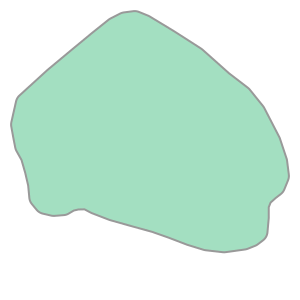

In [38]:
extensions = [
    # '.cpg',
    '.dbf','.prj','.shp','.shx']

url = "https://github.com/mdtanker/RIS_basement_sediment/raw/v2.0/data/shapefiles/"


for i,j in itertools.product(["RIS_tight_outline"], extensions):
    p = pooch.retrieve(
        url=url+i+j,
        path=f"{pooch.os_cache('pooch')}/GRL_2022/shapefiles/",
        fname=i+j,
        known_hash=None,
        progressbar=True,
    )
    if p.endswith(".shp"): shp = p
shp = gpd.read_file(shp).geometry.buffer(40e3)
shp[0]

In [39]:
def plot_3d_groundingline(grid, pen=".7p,black"):
    # plot the grounding/coast lines
    pygmt.grdtrack(
        grid = grid, 
        region=fig_reg,
        points = fetch.groundingline(version="measures-v2"),
        outfile="plotting/GL.txt",
        skiprows=True,
    )
    pygmt.grdtrack(
        grid = grid, 
        region=fig_reg,
        points = fetch.measures_boundaries(version="Coastline"),
        outfile="plotting/CL.txt",
        skiprows=True,
    )
    fig.plot3d(region=persp_reg, data='plotting/GL.txt', 
             pen=pen, perspective=True,
             verbose='e', no_clip=False)
    fig.plot3d(region=persp_reg, data='plotting/CL.txt', 
             pen=pen, perspective=True,
             verbose='e', no_clip=False)  

In [40]:
def plot_draped_contours(
    plot_grid, contour_grid, interval, limit=None, pen=".7p,cyan"):
    fig.grdcontour(
        grid=contour_grid, 
        interval=interval, 
        limit=limit,
        # cut=".1C",
        D="plotting/contours_%c.txt",
        
    )
    pygmt.grdtrack(
        grid = plot_grid, 
        region=fig_reg,
        points = "plotting/contours_C.txt",
        outfile="plotting/draped_contours.txt",
        skiprows=True,
        incols=[0,1], # remove contour depth from file
    )
    fig.plot3d(region=persp_reg, data='plotting/draped_contours.txt', 
             pen=pen, perspective=True,
             verbose='e', no_clip=False) 

grdtrack [WARNING]: Some input points were outside the grid domain(s).
grdtrack [WARNING]: Some input points were outside the grid domain(s).
grdtrack [WARNING]: Some input points were outside the grid domain(s).
grdtrack [WARNING]: Some input points were outside the grid domain(s).
grdtrack [WARNING]: Some input points were outside the grid domain(s).
grdtrack [WARNING]: Some input points were outside the grid domain(s).


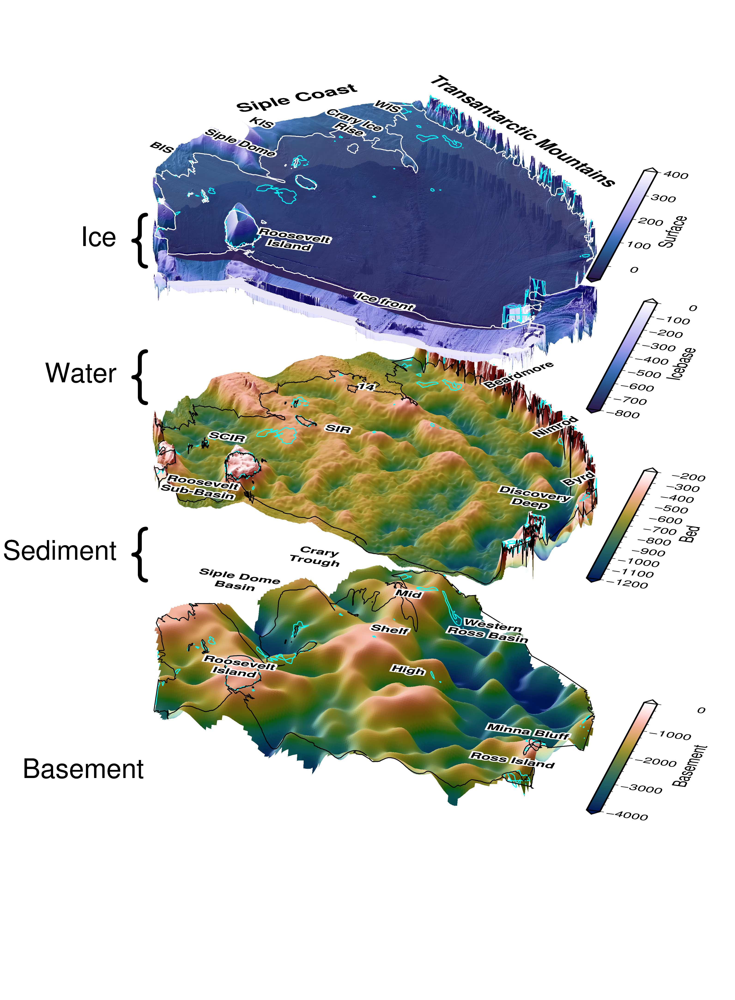

In [41]:
# set perspective view: azimuth, angle
view= [
    165,
    # 190,
    30,
]

fig_reg = [-660_000, 470_000, -1_400_000, -400_000]

fig_proj, proj_ll, fig_width, fig_height = utils.set_proj(
    fig_reg,
    fig_height=18,
)

fig = pygmt.Figure()
persp_reg=fig_reg+[-10000,1000]

grid = basement
grid = utils.mask_from_shp(
    shapefile=shp, xr_grid=grid, masked=True, invert=False
)
# make basement color ramp
pygmt.makecpt(cmap='batlowW', series="-4000/0")
# plot basement
fig.grdview(
    region=persp_reg, 
    projection=fig_proj, 
    frame=None, 
    grid=grid, 
    perspective=view, 
    zsize="7c",  
    surftype="c", 
    #plane='-9000+ggrey',
    # shading='grdgradient+a45+ne.5+m-.2', 
    shading=True,
    cmap=True) 

# plot_draped_contours(
#     grid, sediment_thickness, interval=200, 
#     limit=[199,201], pen=".7p,magenta")
plot_draped_contours(
    grid, ocean_draft_5k, 20, limit=[19,21], pen=".7p,cyan")
plot_3d_groundingline(grid)

# plot location labels, with white shadow
text = "plotting/place_labels_cover_fig_base.tsv"
with open(text, 'w') as f:
    f.write(
        """
        #x, y, [angle, font, justify], text
        100000		-830000		0   TC Western
        100000		-870000		0   TC Ross Basin
        -360000		-1110000	0 	TC Roosevelt
        -360000		-1150000	0 	TC Island
        -320000		-630000		0	TC	Crary
        -320000		-670000		0	TC	Trough
        -450000		-770000 	0   TC Siple Dome
        -450000		-810000 	0   TC Basin
        -100000 	-750000 	0   TC Mid
        -100000 	-900000 	0   TC Shelf
        -20000 	    -1050000 	0   TC High
        280000		-1230000	0   TC Minna Bluff	
        280000      -1350000    0   TC Ross Island
        """
    )
fig.text(textfiles=text, perspective=True, angle=True, font='16p,Helvetica-Bold,black,-=4p,white',
         justify=True, no_clip=True)
fig.text(textfiles=text, perspective=True, angle=True, font='16p,Helvetica-Bold,black',
         justify=True, no_clip=True)

# plot layer label
text='Sediment'
fig.shift_origin(yshift='5c', xshift='2c')
fig.text(position='ML',text="{", font='80p,Courier,black', justify='ML', no_clip=True)
fig.text(position='ML',text=text, font='28p,Helvetica,black', fill='white', justify='MR', no_clip=True)
fig.shift_origin(yshift='-5c', xshift='-2c')

# plot layer label
text='Basement'
fig.shift_origin(yshift='-3c', xshift='3c')
# fig.text(position='ML',text="{", font='80p,Courier,black', justify='ML', no_clip=True)
fig.text(position='ML',text=text, font='28p,Helvetica,black', fill='white', justify='MR', no_clip=True)
fig.shift_origin(yshift='3c', xshift='-3c')

# plot colorbar
frame = 'xa1000f250+lBasement'
bar_width = fig_width * 0.4 # color bar width is 80% of the map width, in cm
pos_str = 'jMR+w' + str(bar_width) + 'c/.5c+v+e+m'
fig.shift_origin(yshift='2c', xshift='-1c')
with pygmt.config(FONT_ANNOT_PRIMARY = '16p,black', FONT_LABEL = '20p,black'):
    fig.colorbar(perspective=True, position=pos_str,
                  cmap = True, box = '+gwhite+c3p',
                  frame = frame, verbose='e')
fig.shift_origin(yshift='-2c', xshift='1c')
 
###########
###########
###########    
fig.shift_origin(yshift='-2.5c')
###########
###########
###########

grid = inverted_bed_full
grid = utils.mask_from_shp(
    shapefile=shp, xr_grid=grid, masked=True, invert=False
)
grid = pygmt.grdclip(
    grid, 
    region=fig_reg, 
    above=[0,0], 
)
pygmt.makecpt(cmap='batlowW', series="-1200/-200")
#plot bed
fig.grdview(
    region=persp_reg, 
    projection=fig_proj, 
    frame=None,
    grid=grid, 
    perspective=view,
    zsize="20c", 
    surftype="c",
    # shading='grdgradient+a45+ne.5+m-.2', 
    shading=True,
    cmap=True,
    transparency=0,
)

# plot_draped_contours(
#     grid, sediment_thickness, interval=200, 
#     limit=[199,201], pen=".7p,magenta")
plot_draped_contours(
    grid, ocean_draft_5k, 20, limit=[19,21], pen=".7p,cyan")
plot_3d_groundingline(grid)

# plot location labels, with white shadow
text = "plotting/place_labels_cover_fig_bed.tsv"
with open(text, 'w') as f:
    f.write("""#x, y, [angle, font, justify], text
        266000		-1120000	0   TC  Discovery
        266000		-1160000	0   TC  Deep
        -400000		-1250000	0   TC  Roosevelt
        -400000		-1290000	0   TC  Sub-Basin
        337834		-1057310	50 	MC	Byrd
        237242		-865813		55 	MC	Nimrod	
        110000		-680000		50 	MC	Beardmore
        -32000		-500000		50 	MC	Shackleton
        -400000    -1070000	    0   MC  SCIR
        -190000    -980000      0   MC  SIR
        -180000    -800000      0   MC  14
        """
        # -500000	    -910000     35  TC  Shirase Coast
    )
fig.text(textfiles=text, perspective=True, angle=True, font='16p,Helvetica-Bold,black,-=4p,white',
         justify=True, no_clip=True)
fig.text(textfiles=text, perspective=True, angle=True, font='16p,Helvetica-Bold,black',
         justify=True, no_clip=True)
# text = "plotting/place_labels_cover_fig_bed2.tsv"
# with open(text, 'w') as f:
#     f.write("""#x, y, [angle, font, justify], text
#         -450000    -1000000	0   MC  SCIR
#         -200000    -720000  0   MC  14
#         """
#     )
# fig.text(textfiles=text, perspective=True, angle=True, font='16p,Helvetica-Bold,black,-=4p,white',
#          justify=True, no_clip=True, offset="j2c/2c+v2p,red")
# fig.text(textfiles=text, perspective=True, angle=True, font='16p,Helvetica-Bold,black',
#          justify=True, no_clip=True, offset="j2c/2c+v2p,red")



# plot layer label
text='Water'
fig.shift_origin(yshift='14c', xshift='2c')
fig.text(position='ML',text="{", font='80p,Courier,black', justify='ML', no_clip=True)
fig.text(position='ML',text=text, font='28p,Helvetica,black', fill='white', justify='MR', no_clip=True)
fig.shift_origin(yshift='-14c', xshift='-2c')

# plot colorbar
bar_width = fig_width * 0.4 # color bar width is 80% of the map width, in cm
pos_str = 'jMR+w' + str(bar_width) + 'c/.5c+v+e+m'
frame = 'xa100f50+l"Bed"'
fig.shift_origin(yshift='13c', xshift='-1c')
with pygmt.config(FONT_ANNOT_PRIMARY = '16p,black', FONT_LABEL = '20p,black'):
    fig.colorbar(perspective=True, position=pos_str,
                  cmap = True, box = '+gwhite+c3p',
                  frame = frame, verbose='e')
fig.shift_origin(yshift='-13c', xshift='1c')

###########
###########
###########
fig.shift_origin(yshift='7c')
###########
###########
###########

grid = bedmachine_icebase
grid = utils.mask_from_shp(
    shapefile=shp, xr_grid=grid, masked=True, invert=False
)
grid = pygmt.grdclip(
    grid, 
    region=fig_reg, 
    above=[0,0], 
    below=[-800,-800],
)
# plot icebase
fig.grdview(
    region=persp_reg, 
    projection=fig_proj,
    frame=None,
    grid=grid,
    perspective=view,
    zsize="20c",
    surftype="c",
    shading=True,
    cmap='devon',
)

# plot_3d_groundingline(grid)

# plot layer label
text='Ice'
fig.shift_origin(yshift='12c', xshift='2c')
fig.text(position='ML',text="{", font='80p,Courier,black', justify='ML', no_clip=True)
fig.text(position='ML',text=text, font='28p,Helvetica,black', fill='white', justify='MR', no_clip=True)
fig.shift_origin(yshift='-12c', xshift='-2c')

# plot colorbar 
frame = 'xa100f50+l"Icebase"'
fig.shift_origin(yshift='12.2c', xshift='-1c')
with pygmt.config(FONT_ANNOT_PRIMARY = '16p,black', FONT_LABEL = '20p,black'):
    fig.colorbar(perspective=True, position=pos_str,
                  cmap = True, box = '+gwhite+c3p',
                  frame = frame, verbose='e')
fig.shift_origin(yshift='-12.2c', xshift='1c')

###########
###########
###########    
fig.shift_origin(yshift='1c')
###########
###########
###########

grid = bedmachine_surface
grid = utils.mask_from_shp(
    shapefile=shp, xr_grid=grid, masked=True, invert=False
)
grid = pygmt.grdclip(
    grid, 
    region=fig_reg, 
    above=[400,400], 
)
# pygmt.makecpt(cmap='devon', series='-100/400', background=True, output='../data/plotting/surface.cpt')

# plot surface
fig.grdview(
    region=persp_reg, 
    projection=fig_proj,
    frame=None,
    grid=grid,
    perspective=view,
    zsize="20c",
    surftype="c",
    cmap='devon', 
    shading=True,
    transparency=10,
)

# plot_draped_contours(
#     grid, sediment_thickness, interval=200, 
#     limit=[199,201], pen=".7p,magenta")
plot_draped_contours(
    grid, ocean_draft_5k, 20, limit=[19,21], pen=".7p,cyan")
plot_3d_groundingline(grid, pen=".8p,white")
 
# plot location labels, with white shadow
text = "plotting/place_labels_cover_fig_surface2.tsv"
with open(text, 'w') as f:
    f.write(""" #x, y, [angle, font, justify], text
        -400000		-550000 	35 TC Siple Coast 
        100000		-550000		-35 TC Transantarctic Mountains 
        """
    )
fig.text(textfiles=text, perspective=True, angle=True, font='24p,Helvetica-Bold,black,-=4p,white',
    justify=True, no_clip=True,)
fig.text(textfiles=text, perspective=True, angle=True, font='24p,Helvetica-Bold,black',
    justify=True, no_clip=True,)

text = "plotting/place_labels_cover_fig_surface.tsv"
with open(text, 'w') as f:
    f.write(""" #x, y, [angle, font, justify], text
        -450000		-750000 	-20 TC Siple Dome 
        -250000		-600000		-20 TC Crary Ice 
        -250000		-640000	    -20 TC Rise 
        -200000		-530000		-20 TC WIS
        -430000		-660000 	-20 TC KIS 
        -600000		-810000 	-20 TC BIS 
        -250000		-1090000	0 	TC Roosevelt 
        -250000		-1130000	0 	TC Island 
        0           -1300000    -10 TC Ice front
        """
    )
fig.text(textfiles=text, perspective=True, angle=True, font='16p,Helvetica-Bold,black,-=4p,white',
    justify=True, no_clip=True,)
fig.text(textfiles=text, perspective=True, angle=True, font='16p,Helvetica-Bold,black',
    justify=True, no_clip=True,)

# plot colorbar
frame = 'xa100f00+l"Surface"'
fig.shift_origin(yshift='16c', xshift='-1c')
with pygmt.config(FONT_ANNOT_PRIMARY = '16p,black', FONT_LABEL = '20p,black'):
    fig.colorbar(perspective=True, position=pos_str, cmap = True, 
                 box = '+gwhite+c3p', frame = frame, verbose='e')
fig.shift_origin(yshift='-16c', xshift='1c')
fig.show()

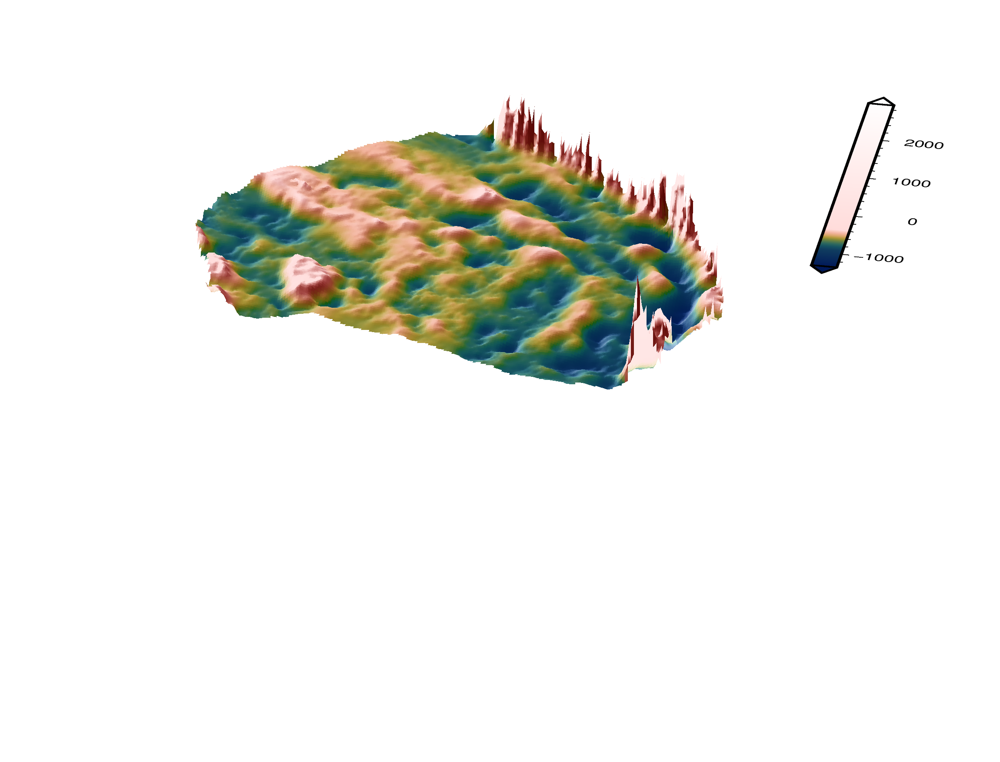

In [42]:
grids = [
    inverted_bed,
]
fig = maps.plot_3d(
    grids=grids,
    cmaps=["batlowW"],#, "cork", "devon", "devon"],
    exaggeration=[7],#, 20, 20, 20],
    # cbar_labels=["basement", "bed", "icebase", "surface"],
    shp_mask=shp,
    region=region,
    # cbar_xshift=[0, 0, 0, 0],
    # cbar_yshift=[2, 13, 13, 15.5],
    # zshifts=[-5, 4, 1.3, 0.5],
    # transparencies=[0, 0, 0, 20],
    
)

fig.show()

In [201]:
# gl = fetch.groundingline(version="measures-v2")
# gl = gpd.read_file(gl)
# coast = gpd.read_file(fetch.measures_boundaries(version="Coastline"))
# gl = pd.concat([gl, coast])
# gl_df = gl.get_coordinates()
# gl_df = utils.points_inside_region(gl_df, region,)
# gl_df = profile.sample_grids(
#     gl_df,
#     inverted_bed,
#     name="z",
# ).dropna()

# # gl_df = gpd.GeoDataFrame(
# #     gl_df, geometry=gpd.points_from_xy(gl_df.x, gl_df.y, gl_df.z))
# # # df = gpd.GeoDataFrame(gl_df, geometry = 'geometry')["geometry"]
# # # df1 = df.get_coordinates(include_z=True)
# # gl_df

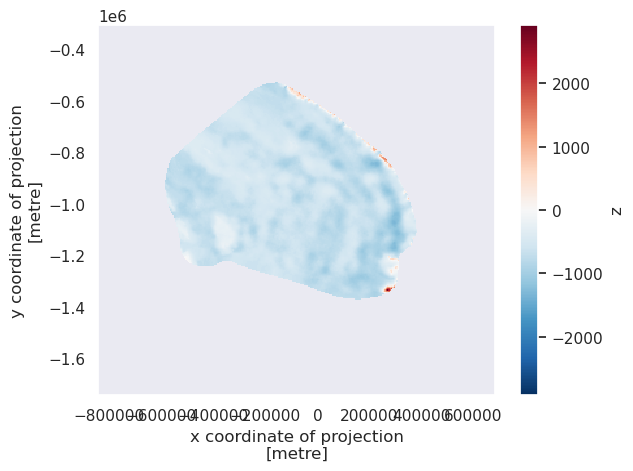

In [43]:
inverted_bed_masked = utils.mask_from_shp(
    shapefile=shp, xr_grid=inverted_bed, masked=True, invert=False
)
inverted_bed_masked.plot()

In [44]:
vd.pad_region(regions.ross_ice_shelf,40e3)

(-720000.0, 510000.0, -1460000.0, -270000.0)

In [45]:
df = vd.grid_to_table(inverted_bed_masked).dropna()
vd.get_region((df.easting, df.northing))

(-585000.0, 380000.0, -1370000.0, -530000.0)

makecpt [WARNING]: Without inc in -T option, -Z has no effect (ignored)


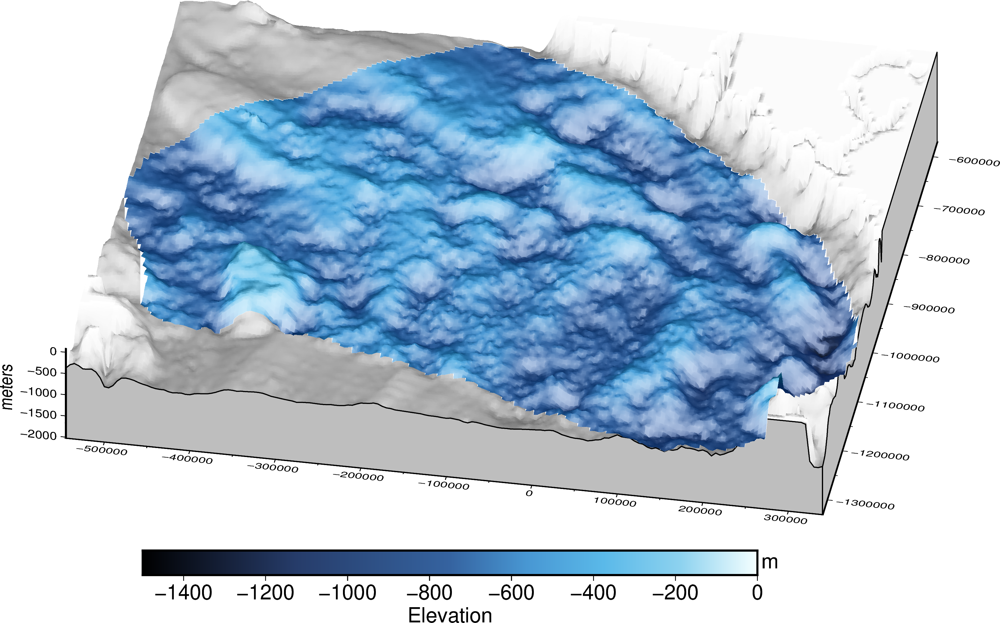

In [32]:
fig = pygmt.Figure()

# reg = vd.pad_region(regions.ross_ice_shelf,40e3)
# reg = tuple(region)
df = vd.grid_to_table(inverted_bed_masked).dropna()
reg = vd.get_region((df.easting, df.northing))
proj, proj_ll, _, fig_height = utils.set_proj(
    reg,
    fig_height=18,
)
perspective=[170,35]


grid = pygmt.grdclip(
    inverted_bed, 
    region=reg, 
    above=[100,100], 
    # below=[-1500, -1500], 
    # between=None, 
    # new=None,
)

reg = reg+(np.nanmin(grid), np.nanmax(grid))

fig.grdview(
    grid=grid,
    region=reg,
    frame=["xa100000f50000","ya100000f50000","z500+lmeters","wSEnZ"],
    perspective=perspective,
    projection=proj, 
    zsize='3c',
    surftype='i',
    cmap="gray",
    plane=f"{np.nanmin(grid)}+ggrey",
    shading=f'+a{perspective[0]}+nt1',
    # shading=True,
)

pygmt.makecpt(cmap='abyss', series=[-1500, 0], continuous=True)
  
fig.grdview(
    grid=inverted_bed_masked,
    region=reg,
    # frame=["xa100000f50000","ya100000f50000","z500+lmeters","wSEnZ"],
    perspective=perspective,
    projection=proj, 
    zsize='3c',
    surftype='i',
    cmap=True,
    # plane=f"{np.nanmin(grid)}+ggrey",
    shading=f'+a{perspective[0]}+nt1',
    # shading=True,
)

# fig.plot3d(
#     data=gl_df,
#     # x=gl_df.x,
#     # y=gl_df.y,
#     # z=gl_df.z,
#     # pen="1p,red",
#     color="red",
#     style="c.05c",
#     no_clip=False,
#     region=reg,
#     perspective=perspective,
#     # projection=proj,
# )

with pygmt.config(FONT='16p'):
    fig.colorbar(cmap=True,frame=["a200", "x+lElevation", "y+lm"])
    
fig.show()


# Magnetics data

In [4]:
# rosetta_mag2 = fetch.ROSETTA_magnetics()
# rosetta_mag2.describe()

## download ROSETTA mag data from Tankersley et al. 2022

In [47]:
path = pooch.retrieve(
    url="https://github.com/mdtanker/RIS_basement_sediment/raw/v2.0/data/input/Geosoft_mag_data.csv.gz",
    fname="Geosoft_mag_data.csv.gz",
    path=f"{pooch.os_cache('pooch')}/GRL_2022",
    known_hash=None,
    progressbar=True,
)
rosetta_mag = pd.read_csv(
    path,
    sep=",",
    header="infer",
    index_col=None,
    compression="gzip",
).dropna(subset="Mag_anom_draped_1000")

rosetta_mag["upward"]=1000

# somehow mag value got shifted off zero
# will shift grid to match ADMAP2 anyway, so shouldn't matter
rosetta_mag["Mag_anom_draped_1000"] -= rosetta_mag.Mag_anom_draped_1000.mean()

# block reduce
rosetta_mag = utils.block_reduce(
    rosetta_mag,
    np.mean,
    spacing=2e3,
    input_coord_names=["x", "y", "upward"],
    input_data_names=["Mag_anom_draped_1000"],
    center_coordinates=False,
    adjust="spacing",
    drop_coords=False,
)
rosetta_mag.describe()

,x,y,upward,Mag_anom_draped_1000
count,23942.000000,2.394200e+04,23942.0,23942.000000
mean,-71529.384995,-9.973873e+05,1000.0,-0.038618
std,224500.552638,1.963208e+05,0.0,96.555876
min,-575938.749021,-1.388120e+06,1000.0,-374.555452
25%,-235962.639232,-1.149992e+06,1000.0,-56.607648
50%,-61987.110670,-1.010200e+06,1000.0,-21.491941
75%,111557.023069,-8.536227e+05,1000.0,36.593615
max,381928.003068,-4.603250e+05,1000.0,743.852676


## grid the data 

In [ ]:
# # make into just ROSETTA grid, with 1km cell size, interpolated 8 cells from datapoints
# rosetta_mag_grid = pygmt.surface(
#     x= rosetta_mag.x, 
#     y=rosetta_mag.y,
#     z=rosetta_mag.Mag_anom_draped_1000, 
#     spacing=2e3, 
#     region=region, 
#     maxradius='10c',
#     tension=1,
#     verbose='e',
# ) 
coords=(rosetta_mag.x,rosetta_mag.y,)
mag_spline = inv_utils.best_SplineCV(
    coordinates=coords,
    data=rosetta_mag.Mag_anom_draped_1000,
    dampings=[1e-7],
    # delayed=True,
)
rosetta_mag_grid  = mag_spline.grid(region=region, spacing=2e3)

# rosetta_mag_grid = vd.convexhull_mask(
#     data_coordinates=coords, 
#     grid=rosetta_mag_grid,
# ).scalars
rosetta_mag_grid = vd.distance_mask(
    data_coordinates=coords, 
    maxdist=10e3, 
    grid=rosetta_mag_grid,
).scalars
rosetta_mag_grid.plot(robust=True)

## get ADMAP2 magnetics compilation

In [10]:
admap2 = fetch.magnetics(version="admap2", spacing=2e3, region=region)

spacing larger than original, filtering and resampling


grdfilter [WARNING]: (x_max-x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdfilter (gmtapi_init_grdheader): Please select compatible -R and -I values
grdsample [WARNING]: Output sampling interval in x exceeds input interval and may lead to aliasing.
grdsample [WARNING]: Output sampling interval in y exceeds input interval and may lead to aliasing.


In [49]:

# # interpolate NaN's in grid
# df = vd.grid_to_table(admap2).dropna()
# coords=(df.easting,df.northing)
# grd = vd.Cubic().fit(coords, df.z)
# admap2_filled = grd.grid(region=region, spacing=2e3).scalars

# # only retain filling with ice shelf
# admap2_filled_RIS = xr.where(
#     rosetta_mag_grid.isnull(),
#     admap2,
#     admap2_filled,
# )

# admap2_filled_RIS.plot(robust=True)

## merge ROSETTA and ADMAP2

In [ ]:
# low-pass filt both to low res to calculate DC shift
# admap2_filt = inv_utils.filter_grid(
#     admap2_filled,
#     filter_width=1000e3,
#     filt_type="lowpass",
# )
# rosetta_mag_grid_filt = inv_utils.filter_grid(
#     rosetta_mag_grid,
#     filter_width=1000e3,
#     filt_type="lowpass",
# )

# # find RMS difference, and remove from ROSETTA
# dif_grid = admap2_filt - rosetta_mag_grid_filt
# dif = utils.RMSE(dif_grid)
# print(dif)

# # interpolate NaN's in diff grid
# df = vd.grid_to_table(dif_grid).dropna()
# coords=(df.easting,df.northing)
# grd = vd.Cubic().fit(coords, df.scalars)
# dif_grid  = grd.grid(region=region, spacing=2e3).scalars

# rosetta_mag_grid_shift = rosetta_mag_grid + dif_grid
# # rosetta_mag_grid_shift.plot(robust=True)

# # find RMS difference, and remove from ROSETTA
# dif2_grid = admap2 - rosetta_mag_grid_shift
# print(utils.RMSE(dif2_grid))

# _ = utils.grd_compare(
#     rosetta_mag_grid,
#     rosetta_mag_grid_shift,
#     plot=True,
#     robust=True,
#     # cmap="balance+h0",
#     # diff_cmap="balance+h0",
#     hist=True,
#     inset=False,
#     plot_type="xarray",
# )

In [ ]:
# save to .nc files
# rosetta_mag_grid_shift.to_netcdf("rosetta_mag.nc")
# admap2_filled_RIS.to_netcdf("admap2.nc")
rosetta_mag_grid.to_netcdf("rosetta_mag.nc")
admap2_filled_RIS.to_netcdf("admap2.nc")

!gmt grdblend rosetta_mag.nc admap2.nc -Grosetta_admap2_merged.nc

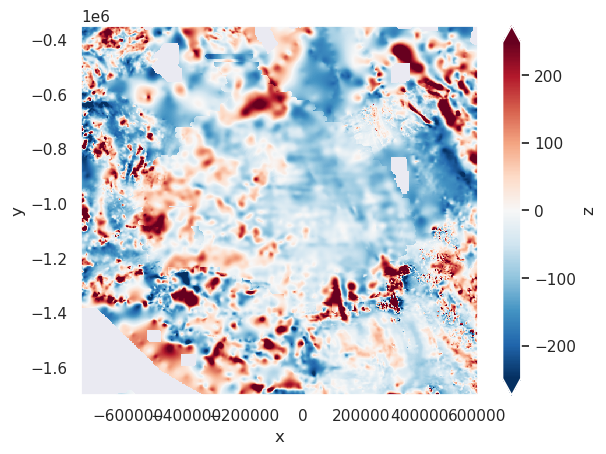

In [30]:
rosetta_admap2_merged = xr.load_dataarray("rosetta_admap2_merged.nc")

rosetta_admap2_merged.plot(robust=True)

grd2cpt [WARNING]: delta+h0 is a discrete CPT. You can stretch it (-T<min>/<max>) but not interpolate it (-T<min>/<max>/<inc>).
grd2cpt [WARNING]: Selecting the given range and ignoring the increment setting.


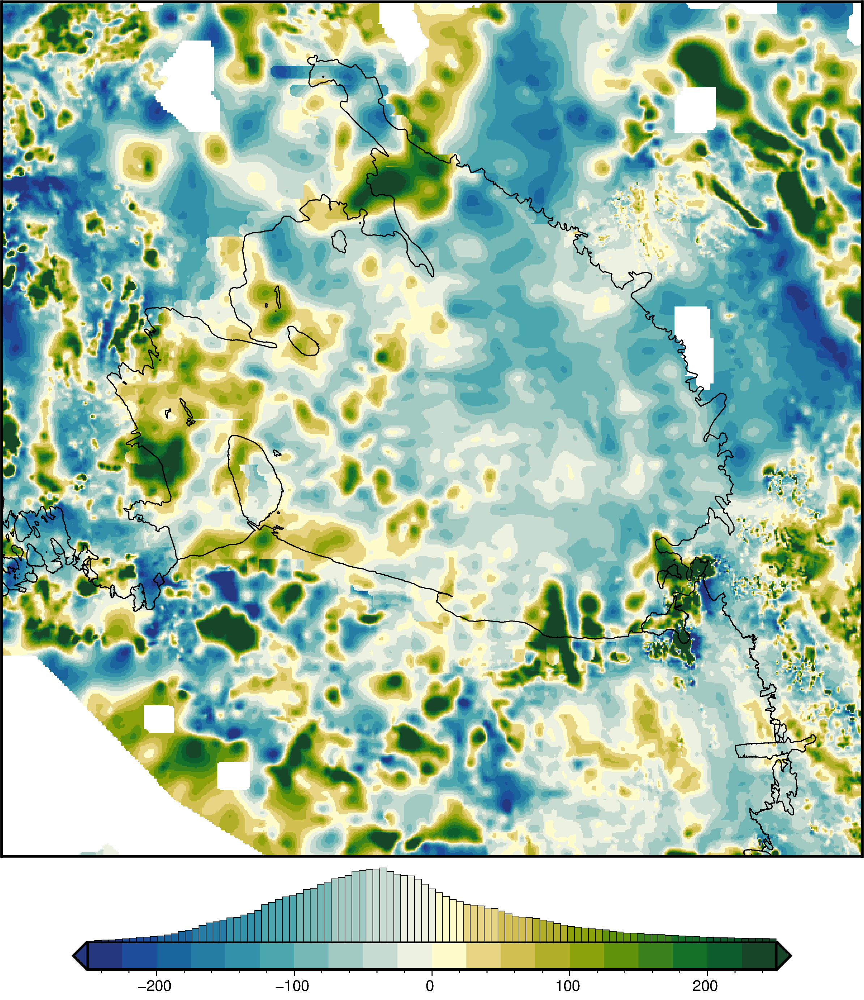

In [7]:
# lims = utils.get_min_max(rosetta_admap2_merged, robust=True)
lims = [-250, 250]
pygmt.grd2cpt(
    grid=rosetta_admap2_merged,
    cmap="delta+h0",
    limit=lims,
    nlevels=21,
    truncate=[-0.9, 0.9],
    background="o",
    output="plotting/tmp.cpt",
)
fig = maps.plot_grd(
    rosetta_admap2_merged,
    fig_height=20,
    # cmap="balance+h0",
    cmap="plotting/tmp.cpt",
    # robust=True,
    # grd2cpt=True,
    cpt_lims=lims,
    hist=True,
    region=region,
    coast=True,
    coast_version="measures-v2",
)

fig.show()

In [12]:
# rosetta_admap2_merged_deriv = inv_utils.filter_grid(
#     rosetta_admap2_merged,
#     # filter_width=1000e3,
#     filt_type="up_deriv",
# )
# rosetta_admap2_merged_deriv.plot(robust=True)

# Gravity data

In [50]:
# rosetta_grav = pd.read_csv(
#     "../RIS_gravity_inversion/data/RIS_topo_corrections_levelled_mean_bed.csv.gz",
#     sep=",",
#     header="infer",
#     index_col=None,
#     compression="gzip",
# )
# # remove CV test points
# rosetta_grav = rosetta_grav[~rosetta_grav.test]
# # rename columns
# rosetta_grav.rename(columns={
#     "Gobs": "disturbance",
# }, inplace=True)

# # drop other columns
# rosetta_grav.drop(rosetta_grav.columns.difference(
#     ['easting','northing', 'upward','disturbance', 'ice_surface_grav', 'water_surface_grav']), axis=1, inplace=True)
# rosetta_grav = rosetta_grav.set_index(['northing','easting']).to_xarray().disturbance
# rosetta_grav.plot(robust=True)


rosetta_grav = pd.read_csv(
    "../RIS_gravity_inversion/data/ROSETTA_2nd_order_levelled.csv.gz",
    sep=",",
    header="infer",
    index_col=None,
    compression="gzip",
)
# rename second to last column to "disturbance"
col = list(rosetta_grav.columns)[-2]
rosetta_grav.rename(columns={col: "disturbance"}, inplace=True)

# drop other columns
rosetta_grav.drop(rosetta_grav.columns.difference(
    ['easting','northing', 'Height','disturbance']), axis=1, inplace=True)

In [63]:
# grav_eqs = hm.EquivalentSources(damping=5e2, depth=25e3, block_size=2e3)

# coords = (
#     rosetta_grav.easting,
#     rosetta_grav.northing,
#     rosetta_grav.Height,
# )
# data = rosetta_grav.disturbance

# grav_eqs.fit(coords, data)

In [388]:
# grid_coords = vd.grid_coordinates(
#     region=region,
#     spacing=2e3,
#     pixel_register=False,
#     extra_coords=1e3,  # upward continue to 1km
# )
# rosetta_grav = eqs.grid(coordinates=grid_coords,data_names=["grav"])

# # rosetta_grav_inner = vd.distance_mask(
# #     data_coordinates=coords, 
# #     maxdist=20e3, 
# #     grid=rosetta_grav,
# # ).grav

# rosetta_grav = vd.distance_mask(
#     data_coordinates=coords, 
#     maxdist=25e3, 
#     grid=rosetta_grav,
# ).grav
# # rosetta_grav=rosetta_grav.grav

# rosetta_grav.plot(robust=True)

Warning, requested spacing (5000.0) is smaller than the original  (10000.0).


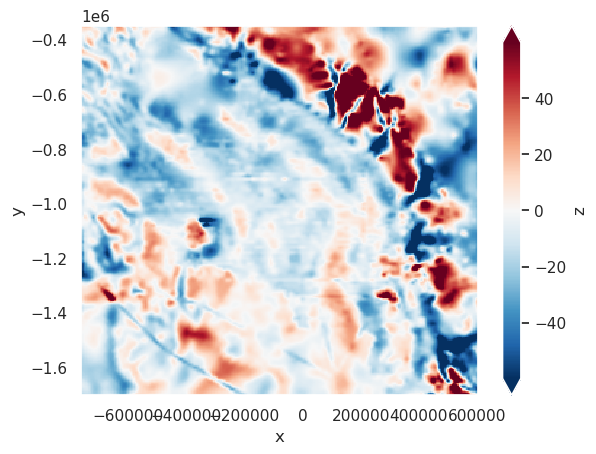

In [11]:
antgg = fetch.gravity(
    version="antgg-update", 
    anomaly_type="DG",
    region=region, 
    spacing=5e3,
).rename({"x":"easting","y":"northing"}).rename("grav")

# aligned = xr.align(antgg, rosetta_grav)

# mask out RIS
# antgg = utils.mask_from_shp(
#     gpd.read_file("../RIS_gravity_inversion/plotting/RIS_outline.shp").buffer(20e3),
#     xr_grid=antgg,
#     masked=True,
#     invert=True,
# )

# antgg = xr.where(
#     aligned[1].isnull(),
#     aligned[0],
#     np.nan,
#     # rosetta_grav.isnull(),
#     # antgg,
#     # np.nan,
# )
antgg.plot(robust=True)

grd2cpt [WARNING]: balance+h0 is a discrete CPT. You can stretch it (-T<min>/<max>) but not interpolate it (-T<min>/<max>/<inc>).
grd2cpt [WARNING]: Selecting the given range and ignoring the increment setting.


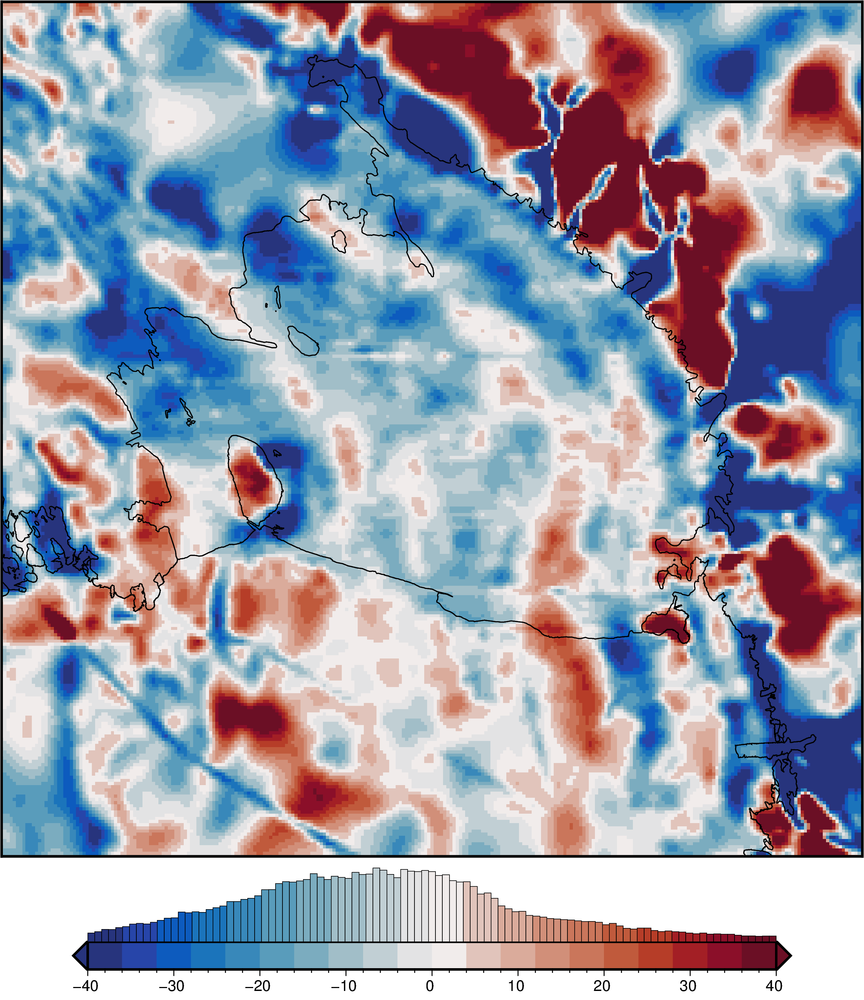

In [9]:
# lims = utils.get_min_max(rosetta_admap2_merged, robust=True)
lims = [-40, 40]
pygmt.grd2cpt(
    grid=antgg,
    cmap="balance+h0",
    limit=lims,
    nlevels=21,
    truncate=[-0.9, 0.9],
    background="o",
    output="plotting/tmp.cpt",
)
fig = maps.plot_grd(
    antgg,
    fig_height=20,
    # cmap="balance+h0",
    cmap="plotting/tmp.cpt",
    # robust=True,
    # grd2cpt=True,
    cpt_lims=lims,
    hist=True,
    region=region,
    coast=True,
    coast_version="measures-v2",
)

fig.show()

In [391]:
# # low-pass filt both to low res to calculate DC shift
# antgg_filt = inv_utils.filter_grid(
#     antgg,
#     filter_width=200e3,
#     filt_type="lowpass",
# )
# rosetta_grav_filt = inv_utils.filter_grid(
#     rosetta_grav,
#     filter_width=200e3,
#     filt_type="lowpass",
# )

# # find RMS difference, and remove from ROSETTA
# dif_grid = antgg_filt - rosetta_grav_filt
# dif = utils.RMSE(dif_grid)
# print(dif)

# # interpolate NaN's in diff grid
# # df = vd.grid_to_table(dif_grid).dropna()
# # coords=(df.easting,df.northing)
# # grd = vd.Cubic().fit(coords, df.grav)
# # dif_grid = grd.grid(region=region, spacing=2e3, data_names=["grav"]).grav
# dif_grid.plot(robust=True)

In [392]:
# rosetta_grav_shift = rosetta_grav + dif_grid
# # rosetta_mag_grid_shift.plot(robust=True)

# # find RMS difference, and remove from ROSETTA
# dif2_grid = antgg - rosetta_grav_shift
# print(utils.RMSE(dif2_grid))

# _ = utils.grd_compare(
#     rosetta_grav,
#     rosetta_grav_shift,
#     plot=True,
#     robust=True,
#     # cmap="balance+h0",
#     # diff_cmap="balance+h0",
#     hist=True,
#     inset=False,
#     plot_type="xarray",
# )

In [393]:
# rosetta_antgg_merged = xr.where(
#     antgg.isnull(),
#     rosetta_grav,
#     antgg
# )
# rosetta_antgg_merged.plot(robust=True)

In [394]:
# # save to .nc files
# rosetta_grav.to_netcdf("rosetta_grav.nc")
# antgg.to_netcdf("antgg.nc")

# !gmt grdblend rosetta_grav.nc antgg.nc -Grosetta_antgg_merged.nc

In [395]:
# rosetta_antgg_merged = xr.load_dataarray("rosetta_antgg_merged.nc")

# rosetta_antgg_merged.plot(robust=True)

# Grav and Mag plot

grd2cpt [WARNING]: delta+h0 is a discrete CPT. You can stretch it (-T<min>/<max>) but not interpolate it (-T<min>/<max>/<inc>).
grd2cpt [WARNING]: Selecting the given range and ignoring the increment setting.
grd2cpt [WARNING]: balance+h0 is a discrete CPT. You can stretch it (-T<min>/<max>) but not interpolate it (-T<min>/<max>/<inc>).
grd2cpt [WARNING]: Selecting the given range and ignoring the increment setting.


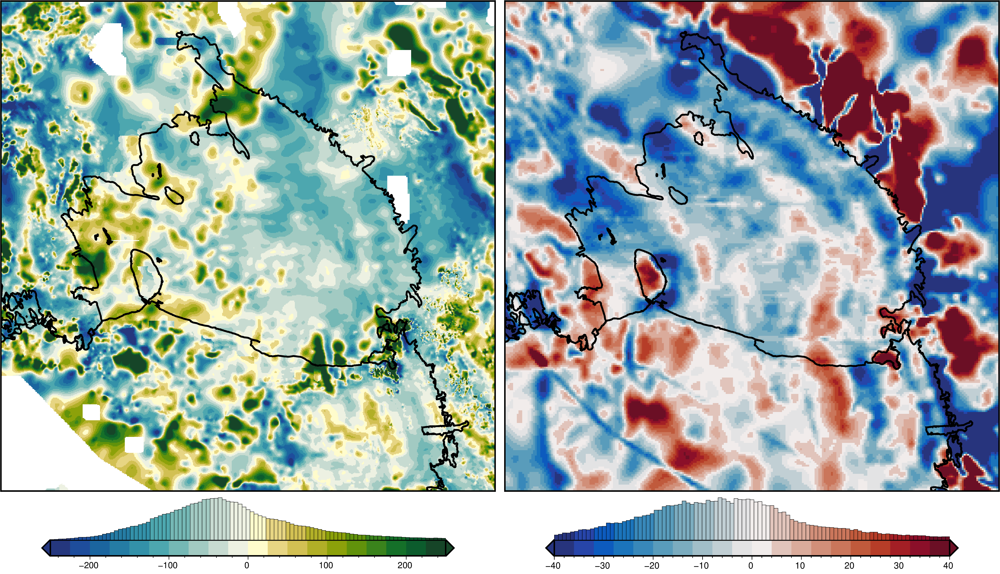

In [396]:
fig_height=20

lims = [-250, 250]
pygmt.grd2cpt(
    grid=rosetta_admap2_merged,
    cmap="delta+h0",
    limit=lims,
    nlevels=21,
    truncate=[-0.9, 0.9],
    background="o",
    output="plotting/tmp.cpt",
)
fig = maps.plot_grd(
    rosetta_admap2_merged,
    fig_height=fig_height,
    # cmap="balance+h0",
    cmap="plotting/tmp.cpt",
    # robust=True,
    # grd2cpt=True,
    cpt_lims=lims,
    hist=True,
    region=region,
    coast=True,
    coast_version="measures-v2",
    coast_pen="2p",
)

lims = [-40, 40]
pygmt.grd2cpt(
    grid=antgg,
    cmap="balance+h0",
    limit=lims,
    nlevels=21,
    truncate=[-0.9, 0.9],
    background="o",
    output="plotting/tmp.cpt",
)
fig = maps.plot_grd(
    antgg,
    fig_height=fig_height,
    # cmap="balance+h0",
    cmap="plotting/tmp.cpt",
    # robust=True,
    # grd2cpt=True,
    cpt_lims=lims,
    hist=True,
    region=region,
    coast=True,
    coast_version="measures-v2",
    coast_pen="2p",
    fig=fig,
    origin_shift="xshift",
)

fig.show()

# Terrain mass effect

In [8]:
# set densities
air_density = 1
ice_density = 915 
water_density = 1024  
earth_density = 2300 

(-800000.0, 640000.0, -1740000.0, -310000.0)

In [43]:
ice_surface_prisms = inv_utils.grids_to_prisms(
    surface=bedmachine_surface,
    reference=0,
    density=xr.where(
        bedmachine_surface >= 0,
        ice_density - air_density,
        air_density - ice_density,
    ),
)

water_surface_prisms = inv_utils.grids_to_prisms(
    surface=bedmachine_icebase,
    reference=0,
    density=xr.where(
        bedmachine_icebase >= 0,
        water_density - ice_density,
        ice_density - water_density,
    ),
)

earth_surface_prisms = inv_utils.grids_to_prisms(
    surface=inverted_bed,
    reference=0,
    density=xr.where(
        inverted_bed >= 0,
        earth_density - water_density,
        water_density - earth_density,
    ),
)

Number of ice surface prisms: 82943
Number of water surface prisms: 82943
Number of earth surface prisms: 82943


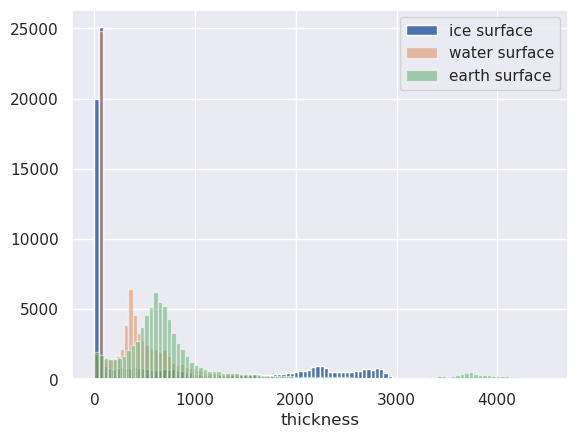

In [44]:
_ = ice_surface_prisms.thickness.plot.hist(bins=100, label="ice surface")
_ = water_surface_prisms.thickness.plot.hist(bins=100, alpha=0.5, label="water surface")
_ = earth_surface_prisms.thickness.plot.hist(bins=100, alpha=0.5, label="earth surface")


print(
    f"Number of ice surface prisms:",
    len(
        ice_surface_prisms.thickness.values[
            ~np.isnan(ice_surface_prisms.thickness.values)
        ]
    ),
)
print(
    f"Number of water surface prisms:",
    len(
        water_surface_prisms.thickness.values[
            ~np.isnan(water_surface_prisms.thickness.values)
        ]
    ),
)
print(
    f"Number of earth surface prisms:",
    len(
        earth_surface_prisms.thickness.values[
            ~np.isnan(earth_surface_prisms.thickness.values)
        ]
    ),
)

plt.legend()

In [45]:
grav_df = vd.grid_to_table(antgg)
grav_df["height"] = 3e3
grav_df.rename(columns={"grav":"disturbance"}, inplace=True)
grav_df

,northing,easting,disturbance,height
0,-1700000.0,-760000.0,-15.469998,3000.0
1,-1700000.0,-755000.0,-15.089998,3000.0
2,-1700000.0,-750000.0,-14.789998,3000.0
3,-1700000.0,-745000.0,-14.378123,3000.0
4,-1700000.0,-740000.0,-14.059999,3000.0
...,...,...,...,...
73978,-350000.0,580000.0,-12.780000,3000.0
73979,-350000.0,585000.0,-12.293125,3000.0
73980,-350000.0,590000.0,-11.790000,3000.0
73981,-350000.0,595000.0,-11.019375,3000.0


In [46]:
# calculate gravity of prisms
_, grav_df = inv_utils.forward_grav_of_prismlayer(
    [
        ice_surface_prisms,
        water_surface_prisms,
        earth_surface_prisms,
    ],
    grav_df,
    names=[
        "ice_surface_grav",
        "water_surface_grav",
        "starting_bed_grav",
    ],
    coord_names=["easting","northing","height"],
    # thickness_threshold=1,
    progressbar=True,
    plot=False,
)
grav_df.rename(columns={"forward_total":"terrain_mass_effect"}, inplace=True)
grav_df["topo_free_disturbance"] = grav_df.disturbance-grav_df.terrain_mass_effect
grav_df.describe()

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

,northing,easting,disturbance,height,ice_surface_grav,water_surface_grav,starting_bed_grav,terrain_mass_effect,topo_free_disturbance
count,7.398300e+04,73983.000000,73983.000000,73983.0,73983.000000,73983.000000,73983.000000,73983.000000,73983.000000
mean,-1.025000e+06,-80000.000000,-5.020760,3000.0,21.991496,-0.298046,-27.579471,-5.886021,0.865261
std,3.911548e+05,394041.578232,25.613470,0.0,34.690988,2.829692,58.588284,86.509399,81.909697
min,-1.700000e+06,-760000.000000,-162.299362,3000.0,-2.419285,-7.507781,-217.735385,-220.319173,-321.781514
25%,-1.365000e+06,-420000.000000,-18.270000,3000.0,-1.815349,-1.909852,-39.413155,-39.160605,-52.038482
50%,-1.025000e+06,-80000.000000,-6.300000,3000.0,0.863812,-0.295241,-31.450884,-30.717692,18.944801
75%,-6.850000e+05,260000.000000,5.312500,3000.0,32.518152,-0.235120,-7.886043,37.776669,34.538644
max,-3.500000e+05,600000.000000,178.029984,3000.0,112.719748,13.260934,155.422504,280.291009,214.592905


In [47]:
grav_df.to_csv(
    "plotting/grav_corrections.csv.gz",
    sep=",",
    header="infer",
    index=None,
    compression="gzip",
)


In [12]:
grav_df = pd.read_csv(
    "plotting/grav_corrections.csv.gz",
    sep=",",
    header="infer",
    index_col=None,
    compression="gzip",
)
grav_df

,northing,easting,disturbance,height,ice_surface_grav,water_surface_grav,starting_bed_grav,terrain_mass_effect,topo_free_disturbance,moho_surface_grav,forward_total,isostatic_anomaly
0,-1700000.0,-760000.0,-15.469998,3000.0,-2.272748,-0.273190,-212.032080,-214.578017,199.108019,-169.584756,-169.584756,368.692775
1,-1700000.0,-755000.0,-15.089998,3000.0,-2.277599,-0.273780,-213.314204,-215.865583,200.775585,-169.922765,-169.922765,370.698350
2,-1700000.0,-750000.0,-14.789998,3000.0,-2.281561,-0.274264,-214.418070,-216.973896,202.183898,-170.108666,-170.108666,372.292564
3,-1700000.0,-745000.0,-14.378123,3000.0,-2.285039,-0.274691,-215.340227,-217.899957,203.521834,-170.239022,-170.239022,373.760856
4,-1700000.0,-740000.0,-14.059999,3000.0,-2.288686,-0.275137,-216.065221,-218.629044,204.569046,-170.392566,-170.392566,374.961612
...,...,...,...,...,...,...,...,...,...,...,...,...
73978,-350000.0,580000.0,-12.780000,3000.0,109.799338,-0.865945,-10.231355,98.702038,-111.482038,-493.357952,-493.357952,381.875914
73979,-350000.0,585000.0,-12.293125,3000.0,109.815897,-0.833711,-9.786968,99.195218,-111.488343,-490.975674,-490.975674,379.487331
73980,-350000.0,590000.0,-11.790000,3000.0,109.904544,-0.796127,-9.326579,99.781838,-111.571838,-487.982072,-487.982072,376.410235
73981,-350000.0,595000.0,-11.019375,3000.0,110.114565,-0.705868,-8.260117,101.148581,-112.167955,-484.197034,-484.197034,372.029078


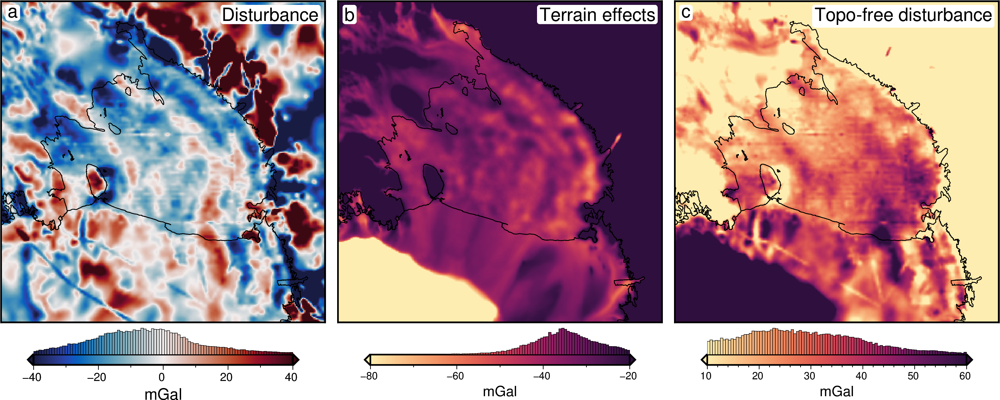

In [119]:
grav_grids = (
    grav_df.set_index(["northing", "easting"]).to_xarray()
)
grids = [
    grav_grids.disturbance,
    grav_grids.terrain_mass_effect,
    grav_grids.topo_free_disturbance,
]
titles = [
    "Disturbance",
    "Terrain effects",
    "Topo-free disturbance",
]
lims = [
    [-40,40], 
    [-80,-20], 
    [10,60],
]

for i, g in enumerate(grids):
    if i == 0:
        fig = None
        origin_shift = "initialize"
        xshift_amount = 1
        yshift_amount = 1
    else:
        fig = fig
        origin_shift = "xshift"
        xshift_amount = 1
        yshift_amount = 1
    
    if i == 0:
        cmap = "balance+h0"
    else:
        cmap = "matter"
    # lims = utils.get_min_max(
    #     g, 
    #     robust=True, 
    #     # shapefile="../RIS_gravity_inversion/plotting/RIS_outline.shp",
    # )
    
    fig = maps.plot_grd(
        grid=g,
        fig_height=10,
        region=region,
        coast=True,
        coast_version="measures-v2",
        cmap=cmap,
        cpt_lims=lims[i],
        cbar_label="mGal",
        hist=True,
        cbar_yoffset=1,
        fig=fig,
        origin_shift=origin_shift,
        xshift_amount=xshift_amount,
        yshift_amount=yshift_amount,
    )
    #plot titles
    fig.text(
        position='TR',
        justify='TR',
        text = titles[i],
        fill = 'white',
        font = '16p,Helvetica,black',
        offset = 'j.2/.2',
        clearance = '+tO',
    )  
    fig.text(
        position='TL',
        text = f"{string.ascii_lowercase[i]}",
        fill = 'white',
        font = '16p,Helvetica,black',
        offset = 'j.2/.2',
        clearance = '+tO',
    )
    
fig.show()

# Isostatic correction

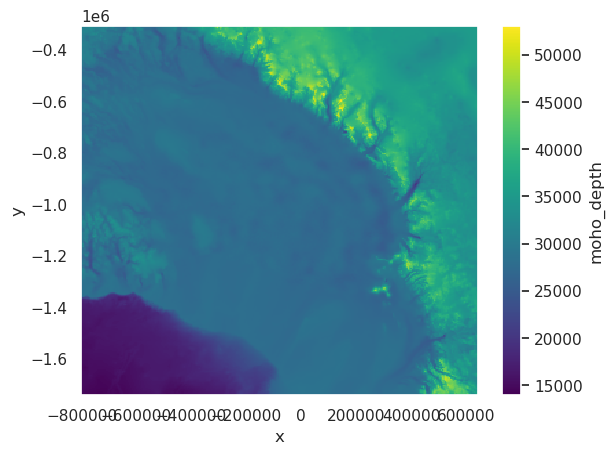

In [200]:
# set densities
air_density = 1
ice_density = 915 
water_density = 1024  
earth_density = 2300 

crust_density = 2800
mantle_density = 3300

# Calculate the water thickness
water_thickness = bedmachine_icebase - inverted_bed
# water_thickness.plot()

# Calculate the ice thickness
ice_thickness = bedmachine_surface - bedmachine_icebase
# ice_thickness.plot()

# Calculate the isostatic Moho depth with the ice and layers
moho_depth = hm.isostatic_moho_airy(
    basement=inverted_bed,
    layers={
        "ice": (ice_thickness, ice_density),
        "water": (water_thickness, water_density),
    },
    density_crust = crust_density,
    density_mantle = mantle_density,
    reference_depth = 30e3,
)
moho_depth.plot()

In [201]:
moho_surface_prisms = inv_utils.grids_to_prisms(
    surface=moho_depth,
    reference=0,
    density=xr.where(
        moho_depth >= 0,
        mantle_density - crust_density,
        crust_density - mantle_density,
    ),
)

In [202]:
# calculate gravity of prisms
_, grav_df = inv_utils.forward_grav_of_prismlayer(
    [
        moho_surface_prisms,
    ],
    grav_df,
    names=[
        "moho_surface_grav",
    ],
    coord_names=["easting","northing","height"],
    # thickness_threshold=1,
    progressbar=True,
    plot=False,
)
grav_df["isostatic_anomaly"] = grav_df.topo_free_disturbance-grav_df.moho_surface_grav
grav_df.describe()

  0%|                                                 | 0/73983 [00:00<?, ?it/s]

,northing,easting,disturbance,height,ice_surface_grav,water_surface_grav,starting_bed_grav,terrain_mass_effect,topo_free_disturbance,moho_surface_grav,forward_total,isostatic_anomaly
count,7.398300e+04,73983.000000,73983.000000,73983.0,73983.000000,73983.000000,73983.000000,73983.000000,73983.000000,73983.000000,73983.000000,73983.000000
mean,-1.025000e+06,-80000.000000,-5.020760,3000.0,21.991496,-0.298046,-27.579471,-5.886021,0.865261,-466.314184,-466.314184,467.179445
std,3.911548e+05,394041.578232,25.613469,0.0,34.690988,2.829692,58.588284,86.509399,81.909697,91.016999,91.016999,30.416609
min,-1.700000e+06,-760000.000000,-162.299360,3000.0,-2.419285,-7.507781,-217.735385,-220.319173,-321.781514,-681.855605,-681.855605,286.556073
25%,-1.365000e+06,-420000.000000,-18.269999,3000.0,-1.815349,-1.909852,-39.413155,-39.160605,-52.038482,-516.579401,-516.579401,452.088929
50%,-1.025000e+06,-80000.000000,-6.300000,3000.0,0.863812,-0.295241,-31.450884,-30.717692,18.944801,-449.962500,-449.962500,470.610442
75%,-6.850000e+05,260000.000000,5.312500,3000.0,32.518152,-0.235120,-7.886043,37.776669,34.538644,-440.797777,-440.797777,482.994883
max,-3.500000e+05,600000.000000,178.029980,3000.0,112.719748,13.260934,155.422504,280.291009,214.592905,-169.584756,-169.584756,678.366797


In [203]:
grav_df.to_csv(
    "plotting/grav_corrections.csv.gz",
    sep=",",
    header="infer",
    index=None,
    compression="gzip",
)


In [13]:
grav_df = pd.read_csv(
    "plotting/grav_corrections.csv.gz",
    sep=",",
    header="infer",
    index_col=None,
    compression="gzip",
)
grav_df

,northing,easting,disturbance,height,ice_surface_grav,water_surface_grav,starting_bed_grav,terrain_mass_effect,topo_free_disturbance,moho_surface_grav,forward_total,isostatic_anomaly
0,-1700000.0,-760000.0,-15.469998,3000.0,-2.272748,-0.273190,-212.032080,-214.578017,199.108019,-169.584756,-169.584756,368.692775
1,-1700000.0,-755000.0,-15.089998,3000.0,-2.277599,-0.273780,-213.314204,-215.865583,200.775585,-169.922765,-169.922765,370.698350
2,-1700000.0,-750000.0,-14.789998,3000.0,-2.281561,-0.274264,-214.418070,-216.973896,202.183898,-170.108666,-170.108666,372.292564
3,-1700000.0,-745000.0,-14.378123,3000.0,-2.285039,-0.274691,-215.340227,-217.899957,203.521834,-170.239022,-170.239022,373.760856
4,-1700000.0,-740000.0,-14.059999,3000.0,-2.288686,-0.275137,-216.065221,-218.629044,204.569046,-170.392566,-170.392566,374.961612
...,...,...,...,...,...,...,...,...,...,...,...,...
73978,-350000.0,580000.0,-12.780000,3000.0,109.799338,-0.865945,-10.231355,98.702038,-111.482038,-493.357952,-493.357952,381.875914
73979,-350000.0,585000.0,-12.293125,3000.0,109.815897,-0.833711,-9.786968,99.195218,-111.488343,-490.975674,-490.975674,379.487331
73980,-350000.0,590000.0,-11.790000,3000.0,109.904544,-0.796127,-9.326579,99.781838,-111.571838,-487.982072,-487.982072,376.410235
73981,-350000.0,595000.0,-11.019375,3000.0,110.114565,-0.705868,-8.260117,101.148581,-112.167955,-484.197034,-484.197034,372.029078


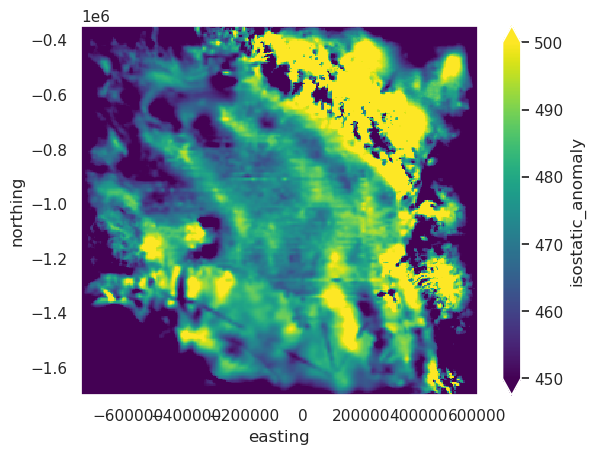

In [205]:
grav_grids = (
    grav_df.set_index(["northing", "easting"]).to_xarray()
)
grav_grids.isostatic_anomaly.plot(vmin=450, vmax=500)

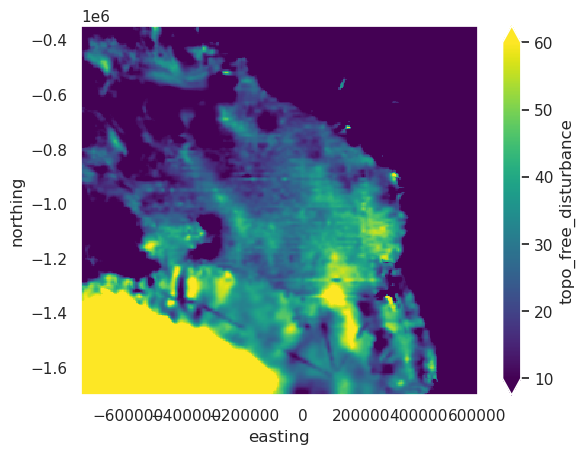

In [145]:
grav_grids.topo_free_disturbance.plot(vmin=10, vmax=60)

# GeoMap geologic data

In [14]:
faults = fetch.geomap(version="faults", region = region)
print("EXPOSURE:", faults.EXPOSURE.unique())
print("TYPENAME:", faults.TYPENAME.unique())
print("ACTIVITY:", faults.ACTIVITY.unique())
faults.columns

EXPOSURE: ['concealed' 'unknown' 'exposed']
TYPENAME: ['fault' 'sinistral strike slip fault' 'normal fault'
 'high angle normal fault' 'dextral strike slip fault'
 'high angle reverse' 'thrust fault']
ACTIVITY: ['inactive' 'probably inactive' 'possibly active' 'active']


Index(['objectid', 'NAME', 'DESCR', 'TYPENAME', 'TYPE_URI', 'ACCURACY',
       'EXPOSURE', 'ACTIVITY', 'DEFRMSTYLE', 'DEFRM_URI', 'MVTTYPE',
       'MVTTYP_URI', 'DISPLCMNT', 'DOWNQUAD', 'DIP_DEG', 'DIPDIR_DEG',
       'GEOLHIST', 'REPAGE_URI', 'YNGAGE_URI', 'OLDAGE_URI', 'OBSMETHOD',
       'CONFIDENCE', 'POSACC_M', 'SOURCE', 'METADATA', 'RESSCALE', 'CAPTSCALE',
       'CAPTDATE', 'MODDATE', 'PLOTRANK', 'FEATUREID', 'SPEC_URI', 'SYMBOL',
       'Shape_Length', 'geometry'],
      dtype='object')

In [15]:
geologic_units = fetch.geomap(version="units", region = region)
print("Columns:", geologic_units.columns)
print("POLYGTYPE:", geologic_units.POLYGTYPE.unique())
print("SIMPCLASS:", geologic_units.SIMPCLASS.unique())
print("SIMPDESC:", geologic_units.SIMPDESC.unique())
print("SIMPCODE:", geologic_units.SIMPCODE.unique())
print("TYPENAME:", geologic_units.TYPENAME.unique())

Columns: Index(['objectid', 'MAPSYMBOL', 'PLOTSYMBOL', 'NAME', 'DESCR', 'POLYGTYPE',
       'MBREQUIV', 'FMNEQUIV', 'SBGRPEQUIV', 'GRPEQUIV', 'SPGRPEQUIV',
       'TERREQUIV', 'STRATRANK', 'SIMPCODE', 'SIMPCLASS', 'SIMPDESC',
       'TYPENAME', 'TYPE_URI', 'LITHOLOGY', 'REPLITH_URI', 'GEOLHIST',
       'REPAGE_URI', 'YNGAGE_URI', 'OLDAGE_URI', 'ABSMIN_MA', 'ABSMAX_MA',
       'AGECODE', 'LITHCODE', 'SOURCECODE', 'SOURCE', 'OBSMETHOD',
       'CONFIDENCE', 'POSACC_M', 'METADATA', 'FEATUREID', 'REGION', 'TECTPROV',
       'RESSCALE', 'CAPTSCALE', 'CAPTDATE', 'MODDATE', 'SPEC_URI', 'SYMBOL',
       'Shape_Length', 'Shape_Area', 'geometry', 'SIMPsymbol', 'SIMPcolor'],
      dtype='object')
POLYGTYPE: ['moraine' 'rock' 'ice']
SIMPCLASS: ['Quaternary-Neogene' 'Cenozoic' 'Mesozoic-Cenozoic' 'Paleozoic-Mesozoic'
 'Proterozoic-Paleozoic' 'Archean' 'Other']
SIMPDESC: ['Unconsolidated colluvium, talus, alluvium and undifferentiated till'
 'Youngest glacial gravel, till and supraglacial material (

In [129]:
df = geologic_units[["SIMPsymbol", "SIMPcolor", "SIMPDESC"]].drop_duplicates()

pygmt.makecpt(
    cmap=','.join(df.SIMPcolor.values), 
    color_model="+c"+",".join(list(df.SIMPsymbol.astype(str))), 
    series=",".join(list(df.SIMPsymbol.astype(str))),
    output="plotting/geology.cpt",
)
df

,SIMPsymbol,SIMPcolor,SIMPDESC
20091,0.0,255/235/175,"Unconsolidated colluvium, talus, alluvium and ..."
3205,1.0,255/255/190,"Youngest glacial gravel, till and supraglacial..."
20849,2.0,211/255/190,"Unconsolidated coastal ice-shelf till, beach o..."
15578,3.0,255/255/0,Older glacial gravel and till (Miocene-Quatern...
10259,5.0,255/0/0,Volcanic rock - basalt to rhyolite lava flows ...
21017,6.0,230/76/0,"Intrusive rock - granite, granodiorite, gabbro..."
17314,9.0,168/112/0,Ferrar Igneous Province and related volcanic a...
20972,10.0,215/158/158,Silicic volcanic and continental sedimentary r...
0,11.0,230/0/169,"Unmetamorphosed granitoid, gabbro and other in..."
13013,13.0,152/230/0,Beacon Supergroup and other sandstone-rich sed...


In [130]:
# Creates a postscript file and writes some explainer text and the column format
with open("plotting/geo_legend.txt", 'w') as f:
    f.write(
        '# G is vertical gap, V is vertical line, N sets # of columns,\n'
        '# D draws horizontal line, H is header, L is column header,\n'
        '# S is symbol,\n' 
        '# format of: symbol position, symbol type,\n' 
        '# format of: symbol size, symbol color, symbol border thickness, text position, text\n'

        'N 1\n'
    )

# Iterates through the unit names and colors, and adds the symbol+text lines to the existing postscript file
with open("plotting/geo_legend.txt", 'a') as f:
    for color, name in zip(df.SIMPcolor, df.SIMPDESC):
        f.write(
            f"S 0.1i r 0.1i {color} 0.1p 0.20i {name}\n"
            '\n'
        )

In [16]:
faults = fetch.geomap(version="faults", region = region)
print("EXPOSURE:", faults.EXPOSURE.unique())
print("TYPENAME:", faults.TYPENAME.unique())
print("ACTIVITY:", faults.ACTIVITY.unique())
faults.columns

EXPOSURE: ['concealed' 'unknown' 'exposed']
TYPENAME: ['fault' 'sinistral strike slip fault' 'normal fault'
 'high angle normal fault' 'dextral strike slip fault'
 'high angle reverse' 'thrust fault']
ACTIVITY: ['inactive' 'probably inactive' 'possibly active' 'active']


Index(['objectid', 'NAME', 'DESCR', 'TYPENAME', 'TYPE_URI', 'ACCURACY',
       'EXPOSURE', 'ACTIVITY', 'DEFRMSTYLE', 'DEFRM_URI', 'MVTTYPE',
       'MVTTYP_URI', 'DISPLCMNT', 'DOWNQUAD', 'DIP_DEG', 'DIPDIR_DEG',
       'GEOLHIST', 'REPAGE_URI', 'YNGAGE_URI', 'OLDAGE_URI', 'OBSMETHOD',
       'CONFIDENCE', 'POSACC_M', 'SOURCE', 'METADATA', 'RESSCALE', 'CAPTSCALE',
       'CAPTDATE', 'MODDATE', 'PLOTRANK', 'FEATUREID', 'SPEC_URI', 'SYMBOL',
       'Shape_Length', 'geometry'],
      dtype='object')

In [17]:
['inactive' 'probably inactive' 'possibly active' 'active']

active = faults[faults.ACTIVITY.isin(["active", "possibly active"])]
inactive = faults[faults.ACTIVITY.isin(["inactive", "probably inactive"])]

ll = faults[faults.TYPENAME.isin(["sinistral strike slip fault"])]
rl = faults[faults.TYPENAME.isin(["dextral strike slip fault"])]

normal = faults[faults.TYPENAME.isin(["normal fault", "high angle normal fault"])]
reverse = faults[faults.TYPENAME.isin(["thrust fault", "high angle reverse"])]

exposed = faults[faults.EXPOSURE.isin(["exposed"])]
inferred = faults[faults.EXPOSURE.isin(["conceled", "unknown"])]

# func for plotting faults
def plot_geomap_faults(
    thickness=.2, 
    color='black', 
):
    fig.plot(
        exposed,
        pen=f'{thickness}p,{color}',
        label="Fault exposed",
    )
    fig.plot(
        inferred,
        pen=f'{thickness}p,{color},-',
        label="Fault hidden/inferred",
    )


Warning 1: The definition of geographic CRS EPSG:4326 got from GeoTIFF keys is not the same as the one from the EPSG registry, which may cause issues during reprojection operations. Set GTIFF_SRS_SOURCE configuration option to EPSG to use official parameters (overriding the ones from GeoTIFF keys), or to GEOKEYS to use custom values from GeoTIFF keys and drop the EPSG code.
Warning 1: The definition of geographic CRS EPSG:4326 got from GeoTIFF keys is not the same as the one from the EPSG registry, which may cause issues during reprojection operations. Set GTIFF_SRS_SOURCE configuration option to EPSG to use official parameters (overriding the ones from GeoTIFF keys), or to GEOKEYS to use custom values from GeoTIFF keys and drop the EPSG code.
Warning 1: The definition of geographic CRS EPSG:4326 got from GeoTIFF keys is not the same as the one from the EPSG registry, which may cause issues during reprojection operations. Set GTIFF_SRS_SOURCE configuration option to EPSG to use officia

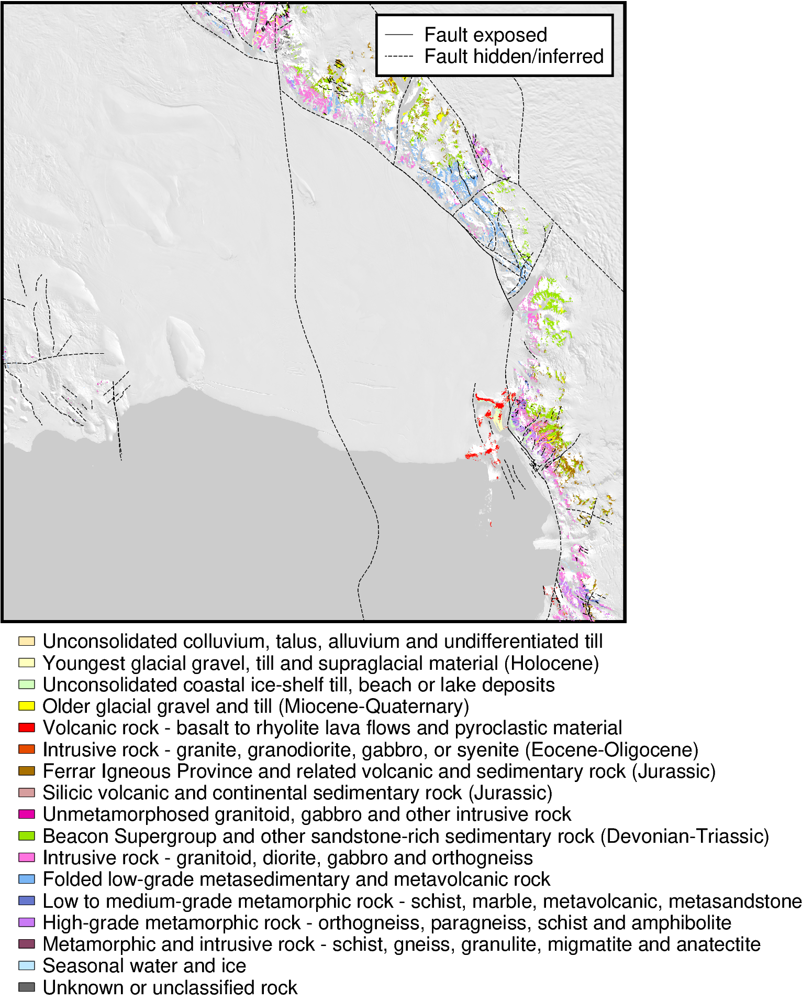

In [157]:
fig_height = 10

fig = maps.plot_grd(
    fetch.modis_moa(),
    image=True,
    cmap="gray",
    region=region,
    fig_height=fig_height,
    transparency=80,
)

fig.plot(
    data = geologic_units[["SIMPsymbol","geometry"]],
    close=True,
    # cmap=True,
    cmap="plotting/geology.cpt",
    # pen=".01p,magenta",
    # pen="1p,+z",
    pen=None,
    fill="+z",
    aspatial="Z=SIMPsymbol",
    region=region,
)

# Plots a legend of the geologic unit names and respective colors
fig.legend(
    spec = "plotting/geo_legend.txt",
    position = 'jBL+jTL+w3/12c', 
)

plot_geomap_faults()

fig.legend()

fig.show()

# Tankersley et. al. 2022 Faults

In [18]:
fnames = [
    "RIS_active_faults",
    "RIS_inactive_faults",
    "RIS_inactive_faults_left_lateral",
    "RIS_inactive_faults_normal",
]
extensions = ['.cpg','.dbf','.prj','.shp','.shx']

url = "https://github.com/mdtanker/RIS_basement_sediment/raw/v2.0/data/shapefiles/"

for i,j in itertools.product(fnames, extensions):
    path = pooch.retrieve(
        url=url+i+j,
        path=f"{pooch.os_cache('pooch')}/GRL_2022/shapefiles/",
        fname=i+j,
        known_hash=None,
        progressbar=True,
    )


In [19]:
fnames = [
    "RIS_active_faults.shp",
    "RIS_inactive_faults.shp",
    "RIS_inactive_faults_left_lateral.shp",
    "RIS_inactive_faults_normal.shp",
]
url = "https://github.com/mdtanker/RIS_basement_sediment/raw/v2.0/data/shapefiles/"

RIS_faults = []
for i in fnames:
    path = pooch.retrieve(
        url=url+i,
        path=f"{pooch.os_cache('pooch')}/GRL_2022/shapefiles/",
        fname=i,
        known_hash=None,
        progressbar=True,
    )
    RIS_faults.append(path)

In [20]:
active, inactive, inactive_ll, inactive_normal = RIS_faults

# func for plotting faults
def plot_RIS_faults(thickness=.2, active_color='magenta', inactive_color='black'):
    pen_fault=f'{thickness}p,{inactive_color},-'#10:2 dash:gap
    hatch_style='f+.2c/.1c+l+i'
    
    # inactive faults, with hatches
    fig.plot(data = inactive_normal, pen=pen_fault)
    fig.plot(data = inactive_normal, pen=f'{thickness}p,{inactive_color},-', style=hatch_style) #f for front, +.6c/0.3c for a tick every .6c, .3c long, +l for left side.
    # left lateral, with arrows
    fig.plot(data = inactive_ll, pen=pen_fault)
    fig.plot(data = inactive_ll, pen=f'{thickness}p,{inactive_color}', style='f-1c/.3c+l+s45+i') #f for front, -1 for 1 arrow, .8c for size of arrow, +l for left side, +s45 for arrow angle, +i for invisible line
    # no kinematics
    fig.plot(data = inactive, pen=pen_fault)
    # active faults, with hatches
    fig.plot(data = active, pen=f'{thickness}p,{active_color},-')
    fig.plot(data = active, pen=f'{thickness}p,{active_color},-', style=hatch_style) # f for front, +.3c/.3c for tick every .3c, .3c long, , +l for left side, +i for invisible        


Warning 1: The definition of geographic CRS EPSG:4326 got from GeoTIFF keys is not the same as the one from the EPSG registry, which may cause issues during reprojection operations. Set GTIFF_SRS_SOURCE configuration option to EPSG to use official parameters (overriding the ones from GeoTIFF keys), or to GEOKEYS to use custom values from GeoTIFF keys and drop the EPSG code.
Warning 1: The definition of geographic CRS EPSG:4326 got from GeoTIFF keys is not the same as the one from the EPSG registry, which may cause issues during reprojection operations. Set GTIFF_SRS_SOURCE configuration option to EPSG to use official parameters (overriding the ones from GeoTIFF keys), or to GEOKEYS to use custom values from GeoTIFF keys and drop the EPSG code.
Warning 1: The definition of geographic CRS EPSG:4326 got from GeoTIFF keys is not the same as the one from the EPSG registry, which may cause issues during reprojection operations. Set GTIFF_SRS_SOURCE configuration option to EPSG to use officia

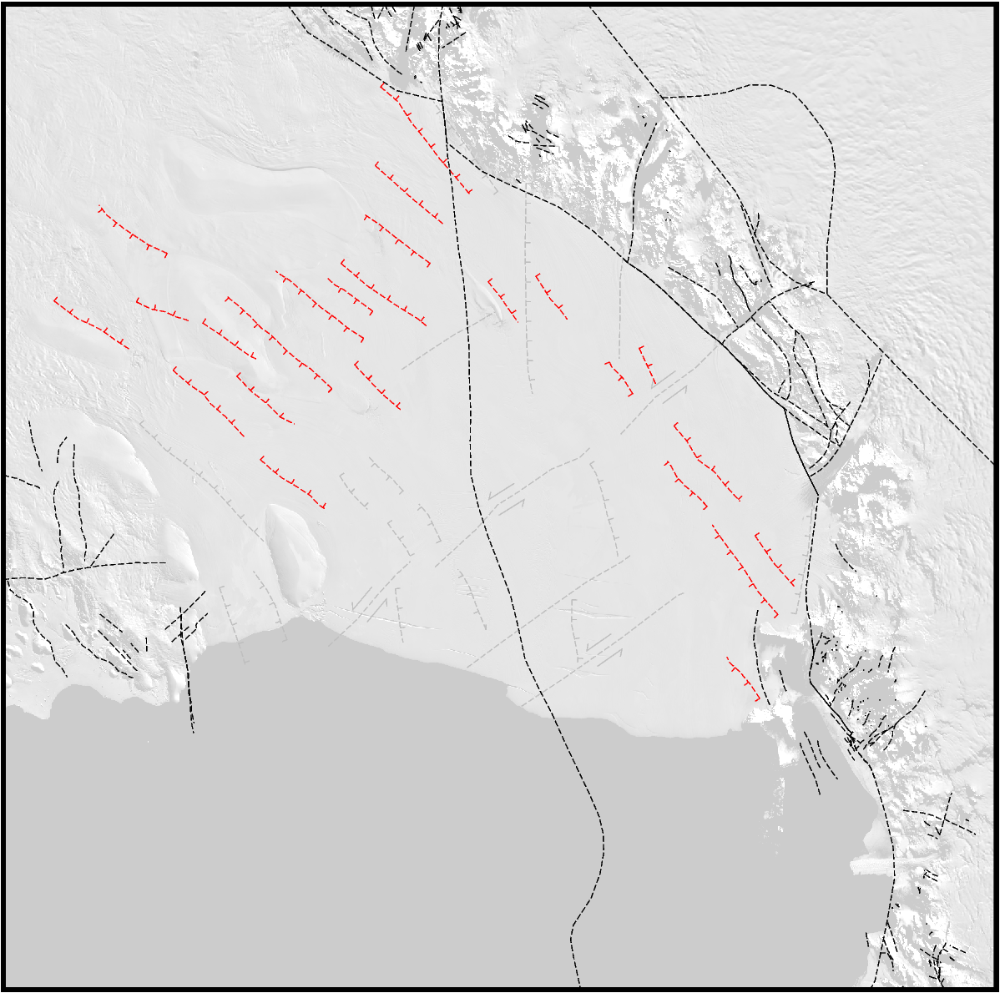

In [161]:
fig_height = 10

fig = maps.plot_grd(
    fetch.modis_moa(),
    image=True,
    cmap="gray",
    region=region,
    fig_height=fig_height,
    transparency=80,
)

plot_RIS_faults(inactive_color="gray", active_color="red")
plot_geomap_faults()
fig.show()

# Bed Classification

In [26]:
url="https://zenodo.org/record/7984586/files/AntarcticBasins_BedTypeCode.tif?download=1"
path = pooch.retrieve(
        url=url,
        path=f"{pooch.os_cache('pooch')}/aitken_2023/",
        fname="AntarcticBasins_BedTypeCode.tif",
        known_hash=None,
        progressbar=True,
    )
grid = xr.load_dataarray(path).squeeze().drop_vars(["band", "spatial_ref"]).rename("z")

In [27]:
bed_type_cmap = {
    "Mixed: In-Situ/Ancient Basin": dict(value='-3.0', color="darkseagreen"),
    "Mixed: Crystalline/In-Situ Basin": dict(value='-2.0', color="aquamarine3"),
    "Mixed: Crystalline/Ancient Basin": dict(value='-1.0', color="lightsteelblue3"),
    "Crystalline Basement": dict(value='0.0', color="gray"),
    "Intrabasin Volcanics": dict(value='1.0', color="orange"),
    "Ancient Basin": dict(value='2.0', color="darkslategray1"),
    "In-Situ Basin": dict(value='3.0', color="darkseagreen1"),
}

In [37]:
values = [v["value"] for k,v in bed_type_cmap.items()]
colors = [v["color"] for k,v in bed_type_cmap.items()]

with pygmt.config(COLOR_NAN = 'white'):
    pygmt.makecpt(
        cmap=','.join(colors), 
        color_model="+c"+",".join(values), 
        series=",".join(values),
        output="plotting/bed_type.cpt",
    )

In [28]:
bed_type = grid.sel(
    x=slice(region[0], region[1]),
    y=slice(region[3], region[2]),
)
types = np.unique(bed_type.values)
types = list(types[np.isfinite(types)].astype(str))

# Creates a postscript file and writes some explainer text and the column format
with open("plotting/bed_type_legend.txt", 'w') as f:
    f.write('N 2\n') # number of columns

# Iterates through the unit names and colors, and adds the symbol+text lines to the existing postscript file
with open("plotting/bed_type_legend.txt", 'a') as f:
    for k, v in bed_type_cmap.items():
        if v["value"] in types:
            f.write(
                f"S 0.1i r 0.1i {v['color']} 0.1p 0.20i {k}\n"
                '\n'
            )

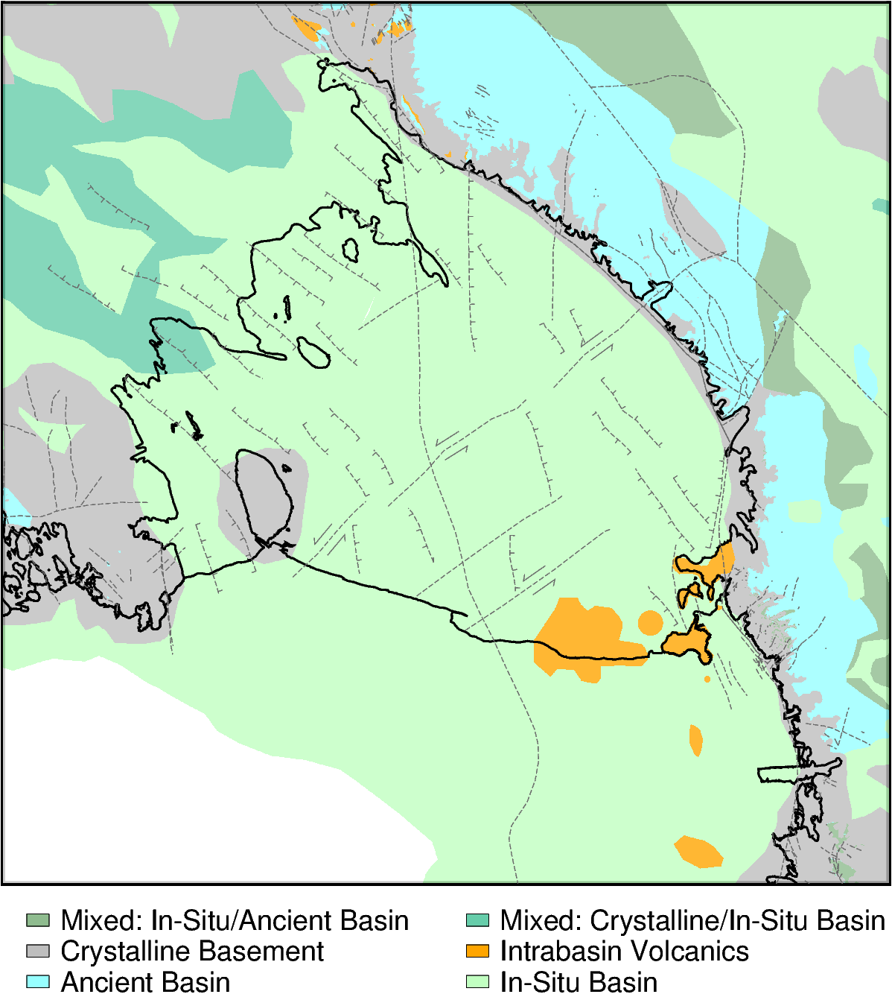

In [176]:
# proj,proj_ll, _, _ = utils.set_proj(
#         region,
#         fig_height=fig_height,
#     )
fig_height=10
fig = maps.basemap(
    region=region,
    fig_height=fig_height,
    frame="+gwhite",
)
# fig = maps.plot_grd(
#     fetch.modis_moa(),
#     image=True,
#     cmap="gray",
#     region=region,
#     fig_height=fig_height,
#     transparency=50,
# )

fig.grdimage(
    bed_type,
    cmap="plotting/bed_type.cpt",
    transparency=20,
)
maps.add_coast(fig, version="measures-v2", pen=".6p,black")

# Plots a legend of the bed types and respective colors
fig.legend(
    spec = "plotting/bed_type_legend.txt",
    position = 'jBL+jTL+w10/12c+o0c/.1c', 
)

plot_RIS_faults(active_color='dimgray', inactive_color='dimgray')
plot_geomap_faults(color="dimgray")

# fig.plot(
#     data = geologic_units[["SIMPsymbol","geometry"]],
#     close=True,
#     cmap="plotting/geology.cpt",
#     pen=".001p,white",
#     # pen=None,
#     fill="+z",
#     aspatial="Z=SIMPsymbol",
#     region=region,
# )
# # Plots a legend of the geologic unit names and respective colors
# fig.legend(
#     spec = "plotting/geo_legend.txt",
#     # position = 'jBL+jTL+w3/12c', 
#     position = 'jTR+jTL+w3/12c', 
# )


fig.show()

# Grav, Mag, and Geology

In [23]:
grav_grids = (
    grav_df.set_index(["northing", "easting"]).to_xarray()
)

In [89]:
df_GHF = fetch.ghf(version="burton-johnson-2020", points=True, region=region)
# df_GHF

In [93]:
# GHF = fetch.ghf(version="burton-johnson-2020", region=region)
GHF = fetch.ghf(version="shen-2020", region=region)


returning grid with new region and/or registration, same spacing


grd2cpt [WARNING]: delta+h0 is a discrete CPT. You can stretch it (-T<min>/<max>) but not interpolate it (-T<min>/<max>/<inc>).
grd2cpt [WARNING]: Selecting the given range and ignoring the increment setting.
mapproject [WARNING]: For a UTM or TM projection, your region -780000.0/620000.0/-1700000.0/-350000.0 is too large to be in degrees and thus assumed to be in meters
grd2cpt [WARNING]: balance+h0 is a discrete CPT. You can stretch it (-T<min>/<max>) but not interpolate it (-T<min>/<max>/<inc>).
grd2cpt [WARNING]: Selecting the given range and ignoring the increment setting.
grd2cpt [WARNING]: thermal is a discrete CPT. You can stretch it (-T<min>/<max>) but not interpolate it (-T<min>/<max>/<inc>).
grd2cpt [WARNING]: Selecting the given range and ignoring the increment setting.
plot [WARNING]: Cannot use auto-legend -l for variable symbol color. Option -l ignored.


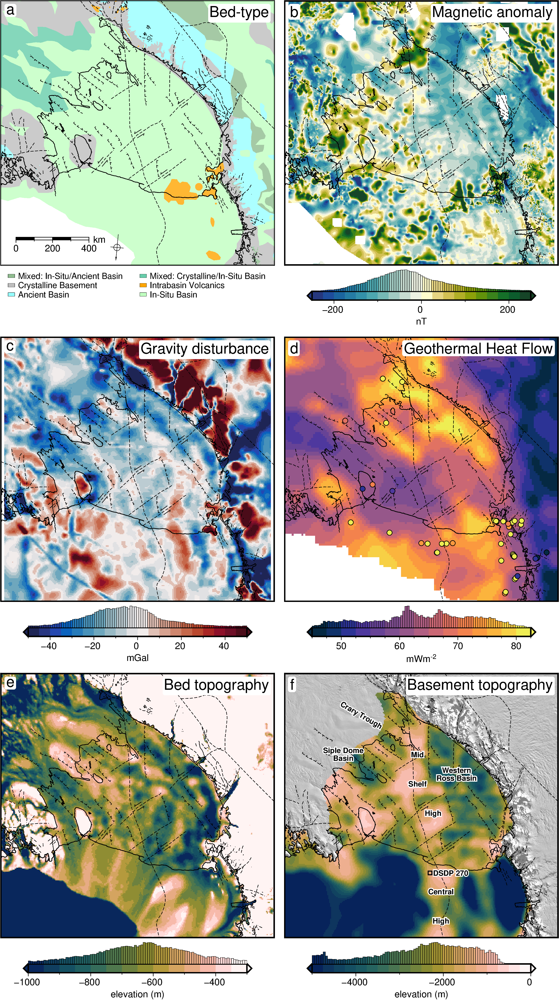

In [95]:
fig_height = 10
region = [-780e3, 620e3, -1700e3, -350e3]

grids = [
    bed_type,
    rosetta_admap2_merged,
    grav_grids.disturbance,
    GHF,
    inverted_bed,
    basement,
]
titles = [
    "Bed-type",
    "Magnetic anomaly",
    "Gravity disturbance",
    "Geothermal Heat Flow",
    "Bed topography",
    "Basement topography",
]
cbar_labels = [
    "",
    "nT",
    "mGal",
    "mWm@+-2@",
    "elevation (m)",
    "elevation (m)",
    "thickness (m)",
]

for i, g in enumerate(grids):
    if i == 0:
        fig = None
        origin_shift = "initialize"
        xshift_amount = 1
        yshift_amount = 1
    elif (i == 2) | (i == 4):
        fig = fig
        origin_shift = "both_shift"
        xshift_amount = -1
        yshift_amount = -.98
    else:
        fig = fig
        origin_shift = "xshift"
        xshift_amount = 1
        yshift_amount = 1
    
    if i == 1:
        lims = [-250, 250]
        pygmt.grd2cpt(
            grid=g,
            cmap="delta+h0",
            limit=lims,
            nlevels=21,
            truncate=[-0.9, 0.9],
            background="o",
            output="plotting/tmp.cpt",
        )
    elif i == 2:
        lims = [-50,50]
        pygmt.grd2cpt(
            grid=g,
            cmap="balance+h0",
            limit=lims,
            nlevels=21,
            # truncate=[-0.95, 0.95],
            background="o",
            output="plotting/tmp.cpt",
        ) 
    elif i == 3:
        lims = [45,82.5]
        pygmt.grd2cpt(
            grid=g,
            cmap="thermal",
            limit=lims,
            nlevels=16,
            # truncate=[-0.95, 0.95],
            background="o",
            output="plotting/tmp.cpt",
        ) 
    elif i == 4:
        lims = [-1000,-300]
        pygmt.grd2cpt(
            grid=g,
            cmap="batlowW",
            limit=lims,
            nlevels=15,
            # truncate=[-0.9, 0.9],
            background="o",
            output="plotting/tmp.cpt",
        ) 
    elif i == 5:
        lims = [-5e3,0]
        pygmt.grd2cpt(
            grid=g,
            cmap="batlowW",
            limit=lims,
            nlevels=21,
            # truncate=[-0.9, 0.9],
            background="o",
            output="plotting/tmp.cpt",
        )
    if i == 0:
        fig = maps.basemap(
            region=region,
            fig_height=fig_height,
            frame="+gwhite",
            fig=fig,
            origin_shift=origin_shift,
            xshift_amount=xshift_amount,
            yshift_amount=yshift_amount,
        )
        fig.grdimage(
            g,
            cmap="plotting/bed_type.cpt",
            transparency=20,
        )
        maps.add_coast(fig, version="measures-v2", pen=".6p,black")
        fig.legend(
            spec = "plotting/bed_type_legend.txt",
            position = 'jBL+jTL+w10/12c+o0c/.1c', 
        )
        
    else:   
        if i == 5:
            fig = maps.plot_grd(
                fetch.modis_moa(),
                image=True,
                cmap="gray",
                region=region,
                fig_height=fig_height,
                transparency=50,
                fig=fig,
                origin_shift=origin_shift,
                xshift_amount=xshift_amount,
                yshift_amount=yshift_amount,
            )
            origin_shift="no_shift"
        if i == 3:
            cbar_frame=["xaf2.5+lmWm@+-2@"]
        else: cbar_frame=None
        fig = maps.plot_grd(
            grid=g,
            fig_height=fig_height,
            region=region,
            coast=True,
            coast_version="measures-v2",
            cmap="plotting/tmp.cpt",
            cpt_lims=lims,
            cbar_label=cbar_labels[i],
            cbar_frame=cbar_frame,
            hist=True,
            cbar_yoffset=1,
            fig=fig,
            origin_shift=origin_shift,
            xshift_amount=xshift_amount,
            yshift_amount=yshift_amount,
        )

    plot_RIS_faults(thickness=.4, active_color='black', inactive_color='black')
    plot_geomap_faults(thickness=.4, color="black")

    if i == 5:
        # plot square for DSDP 270 drill site
        fig.plot(x = -35781, y = -1369331, 
                 pen = '1p,black', style = 's0.2c')
        text = "plotting/tmp.tsv"
        with open(text, 'w') as f:
            f.write(
                """
                #x, y, [angle, font, justify], text
                -20e3       -1369331    0   ML DSDP 270
                
                -100000 	-750000     0   TC Mid
                -100000 	-900000 	0   TC Shelf
                -20000 	    -1050000 	0   TC High

                20000		-1450000	0   TC Central 
                20000		-1600000	0   TC High
                
                100000		-830000		0   TC Western
                100000		-870000		0   TC Ross Basin

                -480000		-728106 	0   TC Siple Dome
                -480000		-768106 	0   TC Basin

                -380000		-550000	    -30 TC Crary Trough
                """
            )
        fig.text(textfiles=text, font='8p,Helvetica-Bold,black,-=2p,white',
                 justify=True, no_clip=True, angle=True,)
        fig.text(textfiles=text, font='8p,Helvetica-Bold,black',
                 justify=True, no_clip=True, angle=True,)
    
    if i == 3:
        fig.plot(
            x=df_GHF.x, 
            y=df_GHF.y, 
            cmap="plotting/tmp.cpt",  
            pen=".5p,black",
            color=df_GHF.GHF,
            style="c.2c",
            label="point measuremnts",
        )
        # fig.legend(position="JBL+jBR")
        
    #plot titles
    fig.text(
        position='TR',
        justify='TR',
        text = titles[i],
        fill = 'white',
        font = '16p,Helvetica,black',
        offset = 'j.2/.2',
        clearance = '+tO',
    )  
    fig.text(
        position='TL',
        text = f"{string.ascii_lowercase[i]}",
        fill = 'white',
        font = '16p,Helvetica,black',
        offset = 'j.2/.2',
        clearance = '+tO',
    )
    if i == 0:
        info = utils.set_proj(
                buffer_region,
                fig_height=fig_height,
            )
        maps.add_scalebar(
            fig, 
            region, 
            info[1], 
            position="n.2/.1",)
        maps.add_north_arrow(fig, region, info[1], position="n.45/.07")
    
fig.show()

# Upper/low uncert

In [96]:
inversion_results = xr.open_zarr("../RIS_gravity_inversion/results/antarctic_wide_results.zarr")
inversion_results

<xarray.Dataset>
Dimensions:    (northing: 13333, easting: 13333)
Coordinates:
  * easting    (easting) int32 -3333000 -3332500 -3332000 ... 3332500 3333000
  * northing   (northing) int32 -3333000 -3332500 -3332000 ... 3332500 3333000
Data variables:
    bed        (northing, easting) float32 dask.array<chunksize=(834, 834), meta=np.ndarray>
    bed_error  (northing, easting) float32 dask.array<chunksize=(834, 834), meta=np.ndarray>

grd2cpt [WARNING]: rain is a discrete CPT. You can stretch it (-T<min>/<max>) but not interpolate it (-T<min>/<max>/<inc>).
grd2cpt [WARNING]: Selecting the given range and ignoring the increment setting.
mapproject [WARNING]: For a UTM or TM projection, your region -600000.0/420000.0/-1390000.0/-390000.0 is too large to be in degrees and thus assumed to be in meters


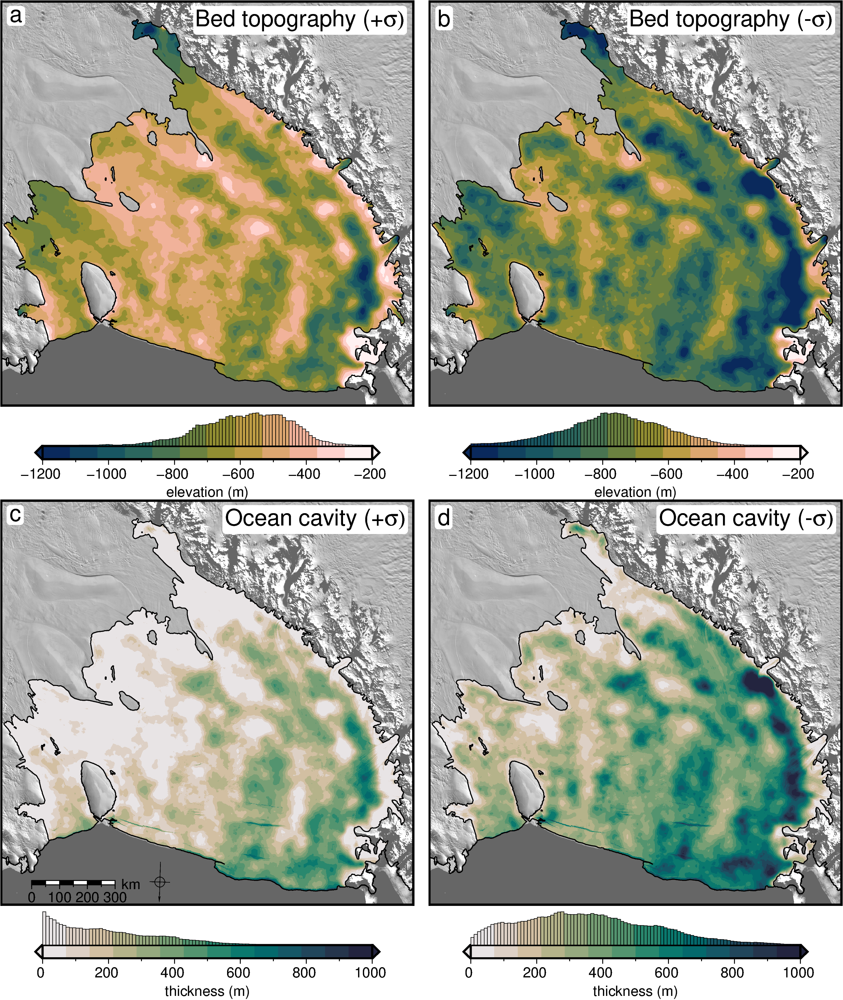

In [74]:
fig_height = 10

region = [-600e3, 420e3, -1420e3, -420e3]

region = utils.alter_region(region, n_shift=-30e3)[0]

upper_bed = inversion_results.bed + inversion_results.bed_error
lower_bed = inversion_results.bed - inversion_results.bed_error
upper_cavity = bedmachine_icebase - upper_bed
lower_cavity = bedmachine_icebase - lower_bed

grids = [
    upper_bed,
    lower_bed,
    upper_cavity,
    lower_cavity,
]
titles = [
    # "Bed topography (+ uncertainty)",
    # "Bed topography (- uncertainty)",
    # "Ocean cavity (+ uncertainty)",
    # "Ocean cavity (- uncertainty)",
    "Bed topography (+@~s)",
    "Bed topography (-@~s)",
    "Ocean cavity (+@~s)",
    "Ocean cavity (-@~s)",
]
cbar_labels = [
    "elevation (m)",
    "elevation (m)",
    "thickness (m)",
    "thickness (m)",
]

for i, g in enumerate(grids):
    if i == 0:
        fig = None
        origin_shift = "initialize"
        xshift_amount = 1
        yshift_amount = 1
    elif i == 2:
        fig = fig
        origin_shift = "both_shift"
        xshift_amount = -1
        yshift_amount = -.95
    else:
        fig = fig
        origin_shift = "xshift"
        xshift_amount = 1
        yshift_amount = 1
    
    # if i in [2,3]:
    g = utils.mask_from_shp(
        "plotting/RIS_outline.shp",
        xr_grid=g,
        masked=True,
        invert=False,
    )
        
    if i == 0:
        lims = [-1200, -200]
        pygmt.grd2cpt(
            grid=g,
            cmap="batlowW",
            limit=lims,
            nlevels=13,
            output="plotting/tmp.cpt",
        )
    elif i == 2:
        lims = [0, 1000]
        pygmt.grd2cpt(
            grid=g,
            cmap="rain",
            limit=[0, lims[1]],
            nlevels=15, 
            output="plotting/tmp.cpt",
        )   

    fig = maps.plot_grd(
        fetch.modis_moa(),
        image=True,
        cmap="gray",
        region=region,
        fig_height=fig_height,
        transparency=40,
        fig=fig,
        origin_shift=origin_shift,
        xshift_amount=xshift_amount,
        yshift_amount=yshift_amount,
    )
    fig = maps.plot_grd(
        grid=g,
        fig_height=fig_height,
        region=region,
        coast=True,
        coast_version="measures-v2",
        cmap="plotting/tmp.cpt",
        cpt_lims=lims,
        cbar_label=cbar_labels[i],
        hist=True,
        cbar_yoffset=1,
        fig=fig,
        origin_shift="no_shift",
    )
    
    #plot titles
    fig.text(
        position='TR',
        justify='TR',
        text = titles[i],
        fill = 'white',
        font = '16p,Helvetica,black',
        offset = 'j.2/.2',
        clearance = '+tO',
    )  
    fig.text(
        position='TL',
        text = f"{string.ascii_lowercase[i]}",
        fill = 'white',
        font = '16p,Helvetica,black',
        offset = 'j.2/.2',
        clearance = '+tO',
    )
    if i == 2:
        info = utils.set_proj(
                buffer_region,
                fig_height=fig_height,
            )
        maps.add_scalebar(
            fig, 
            region, 
            info[1], 
            position="n.25/.07",)
        maps.add_north_arrow(fig, region, info[1], position="n.55/.08")
    
fig.show()